Processing Ca_ppm...
Best variogram parameters for Ca_ppm: Nugget = 0.5, Sill = 0.6, Range = 50.0


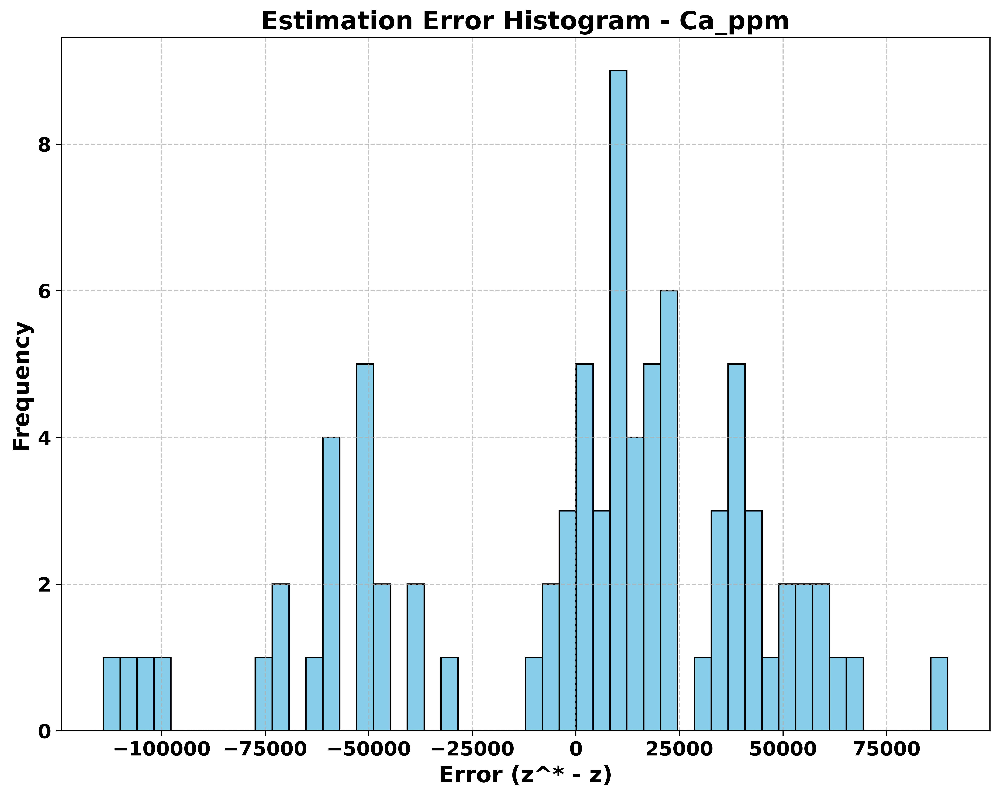

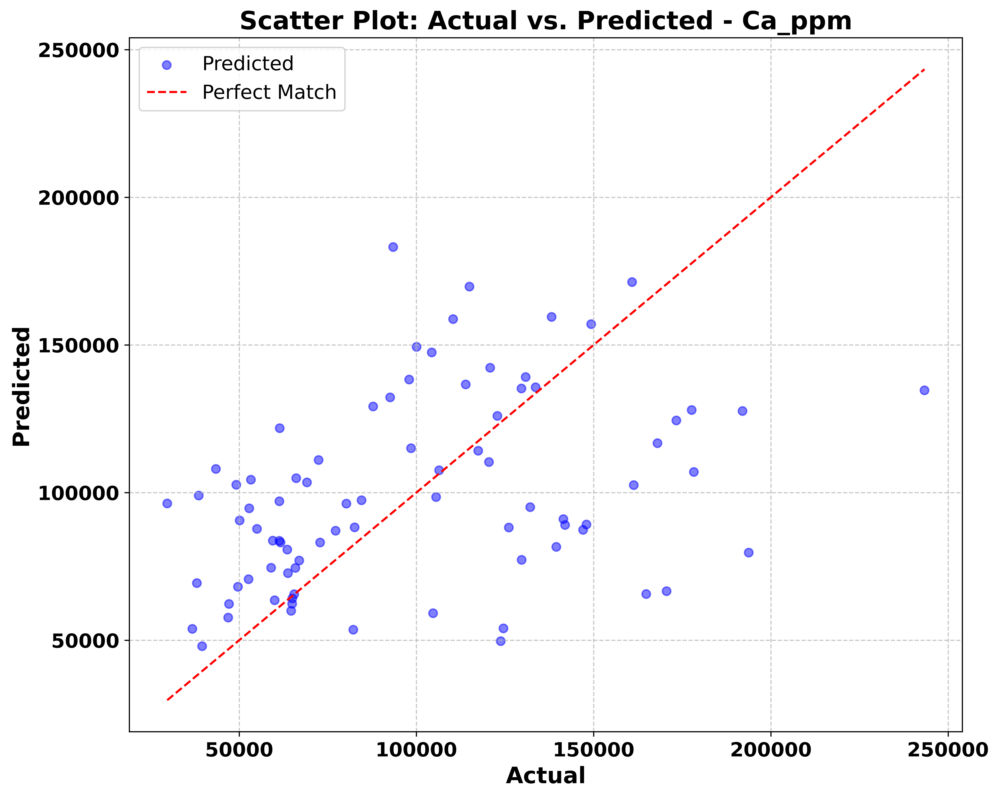

Performing kriging for Ca_ppm on a 150x150 grid for visualization...


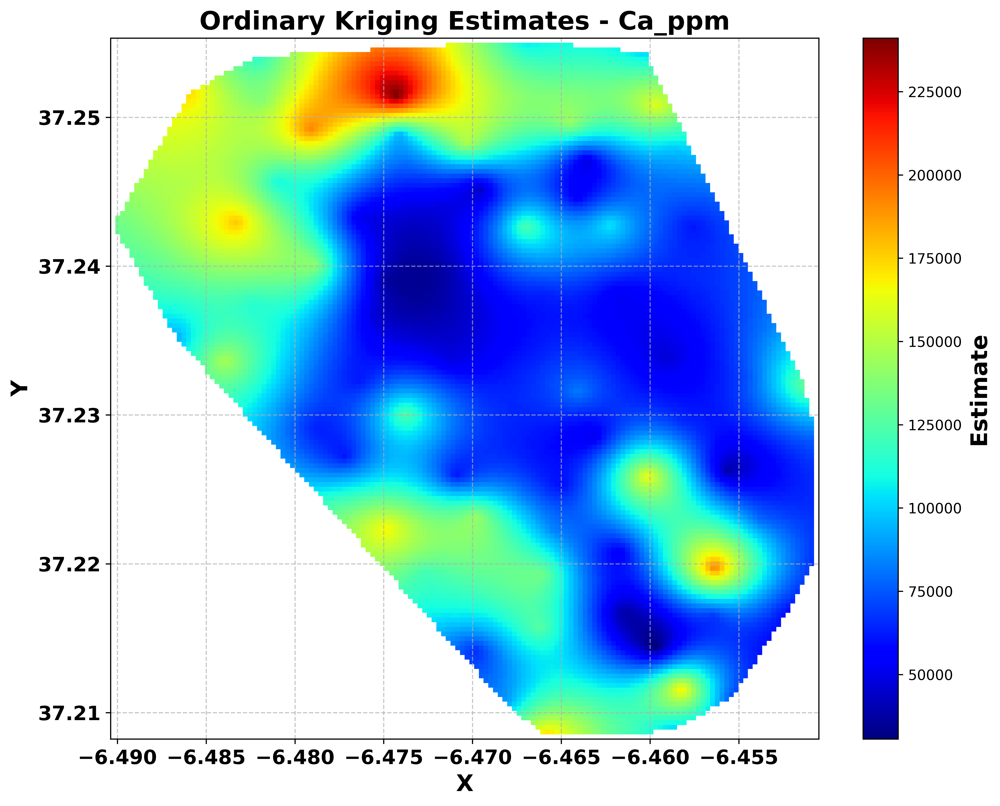

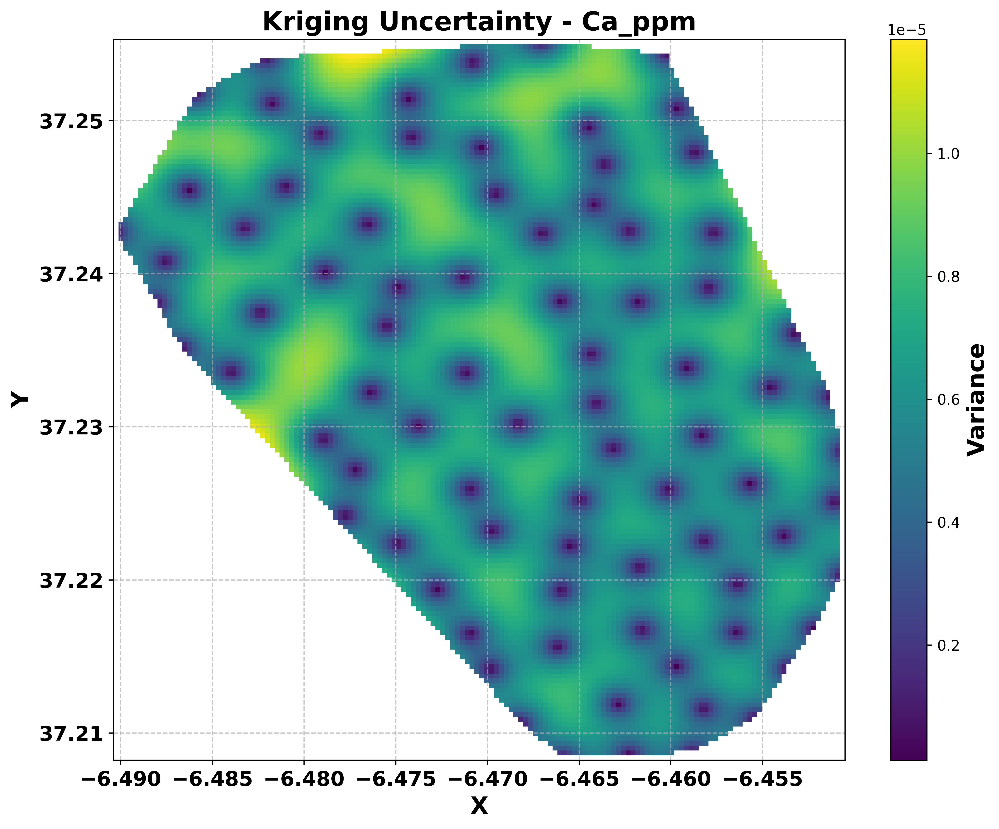

Kriging for Ca_ppm completed.

Processing Cu_ppm...
Best variogram parameters for Cu_ppm: Nugget = 0.4, Sill = 0.5, Range = 50.0


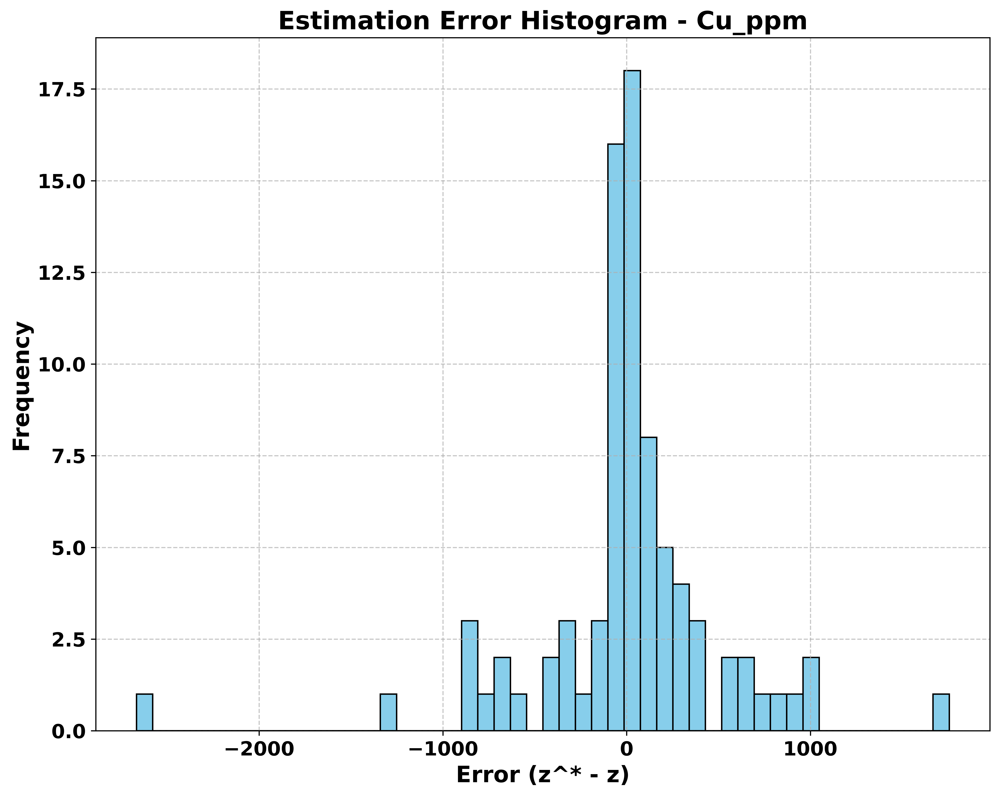

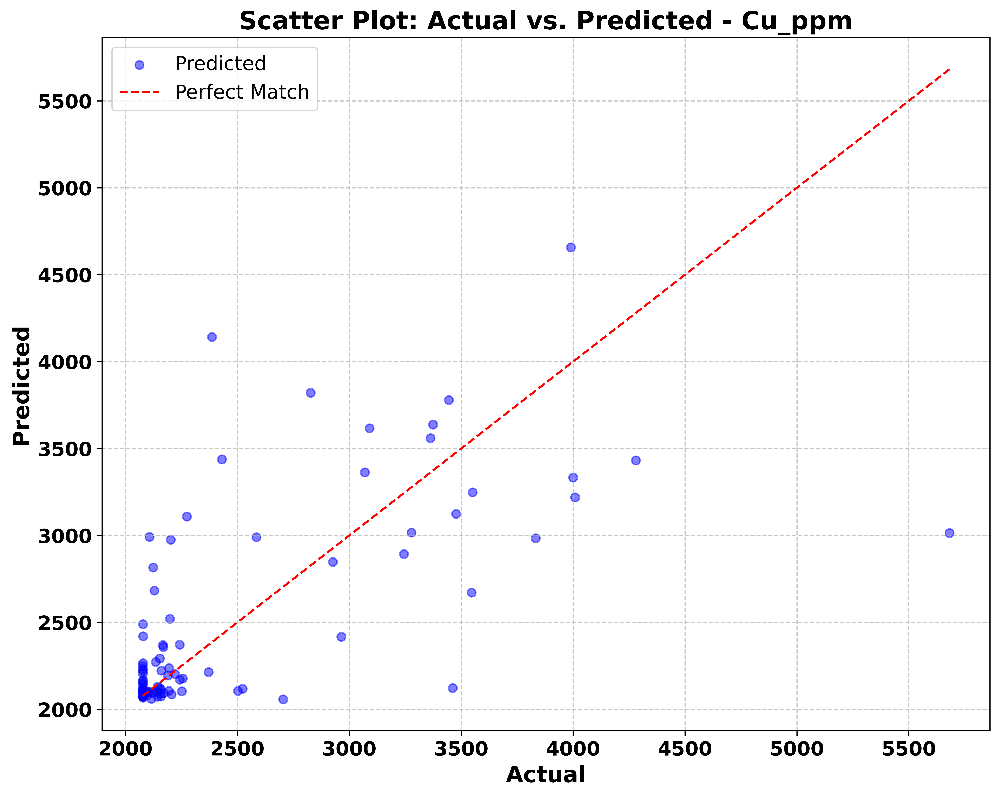

Performing kriging for Cu_ppm on a 150x150 grid for visualization...


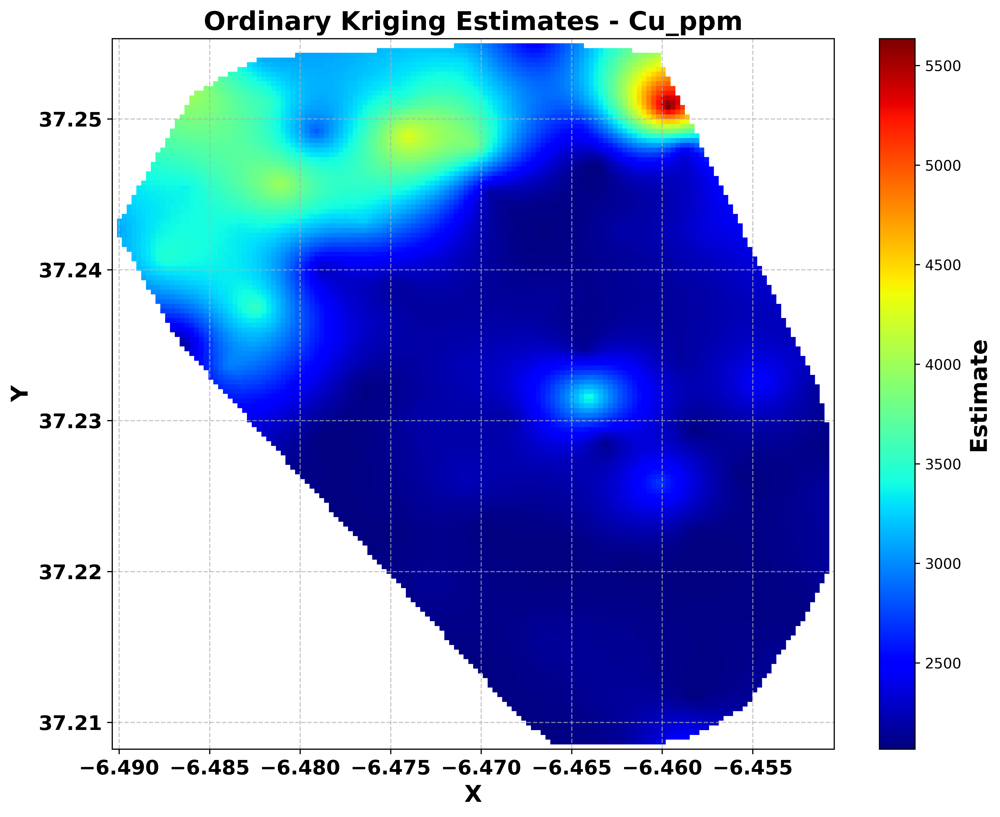

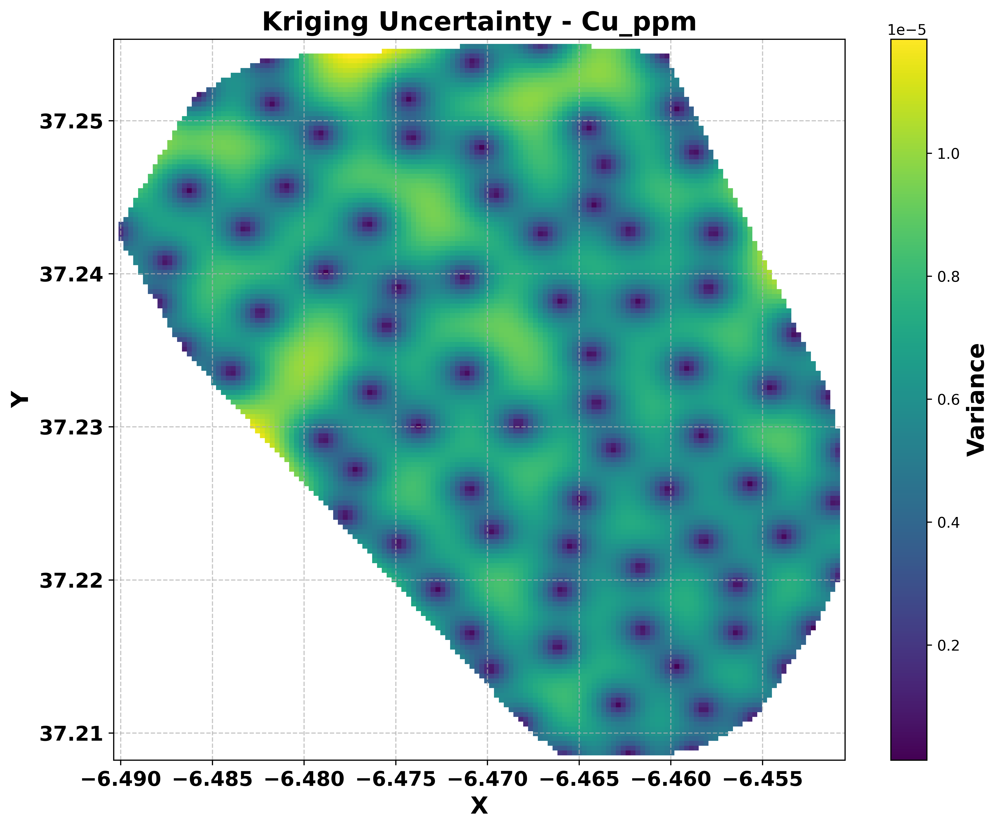

Kriging for Cu_ppm completed.

Processing Fe_ppm...
Best variogram parameters for Fe_ppm: Nugget = 0.4, Sill = 0.5, Range = 50.0


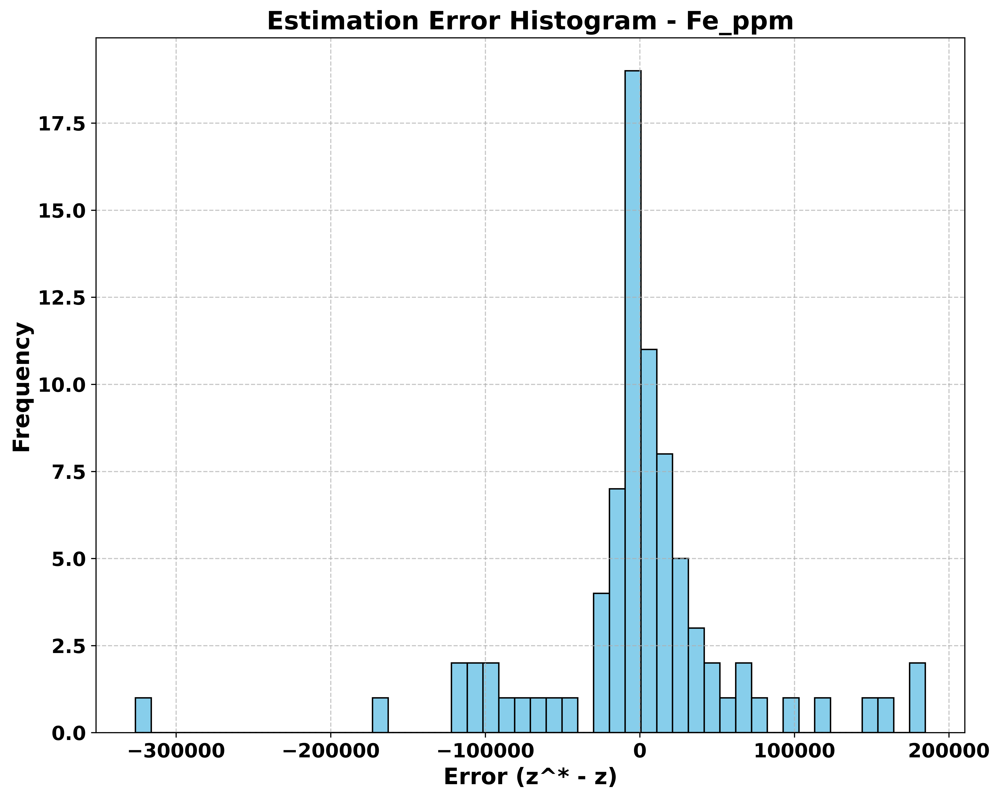

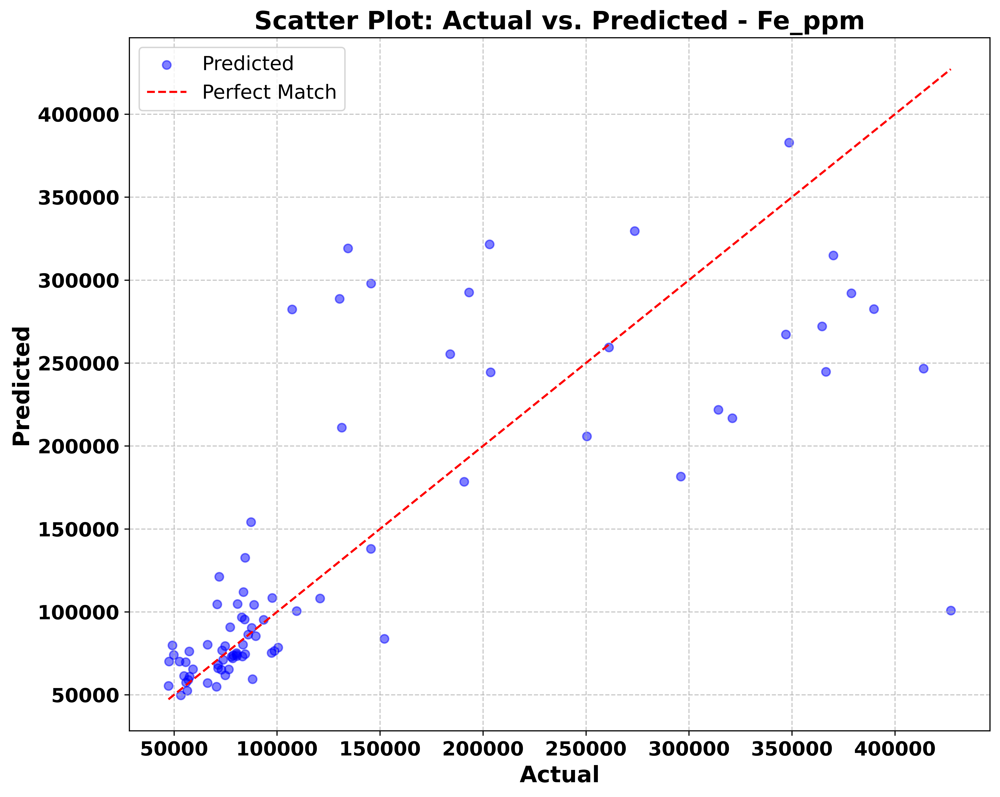

Performing kriging for Fe_ppm on a 150x150 grid for visualization...


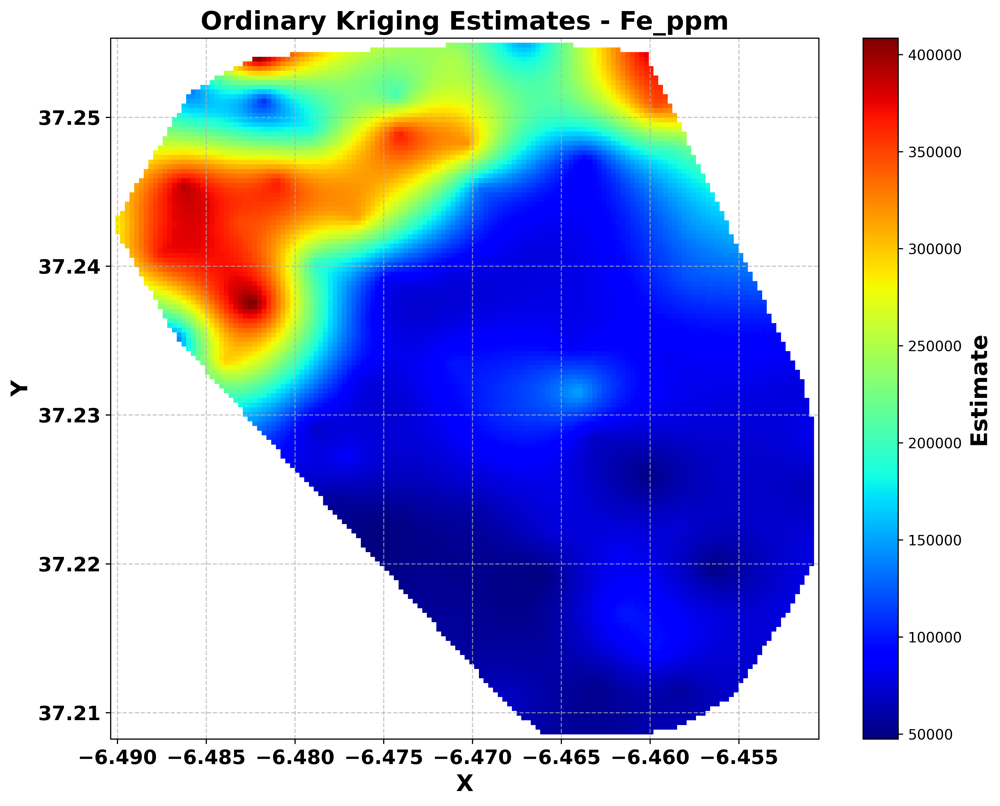

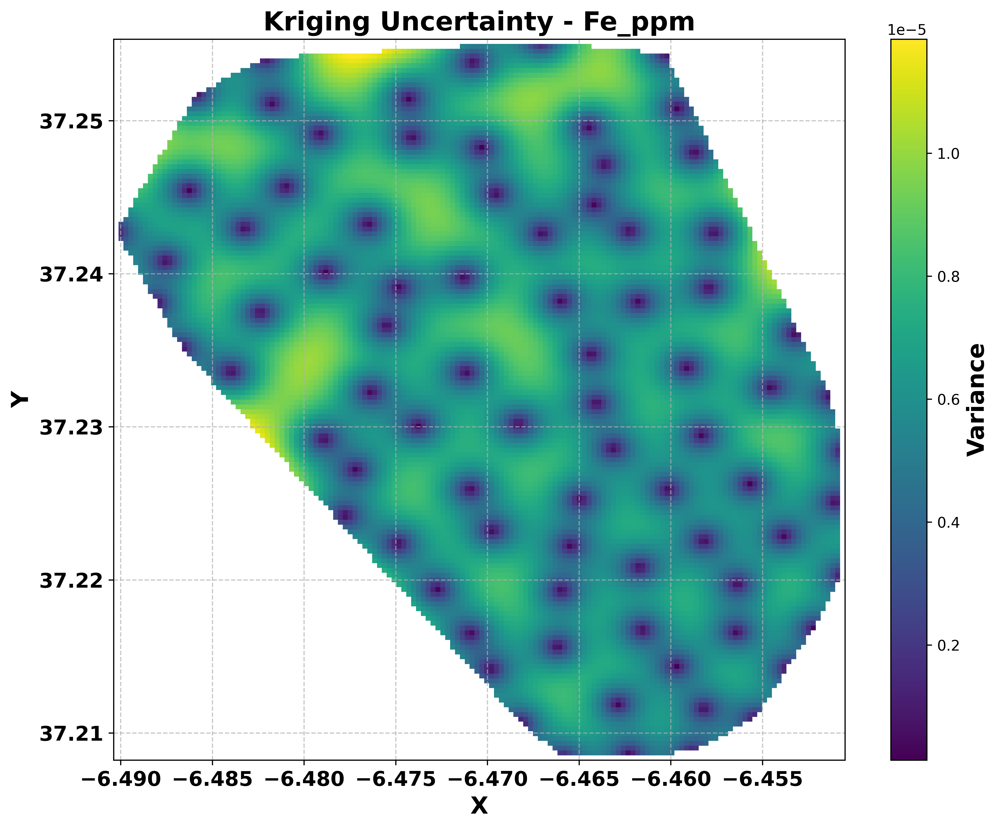

Kriging for Fe_ppm completed.

Processing K_ppm...
Best variogram parameters for K_ppm: Nugget = 0.5, Sill = 0.6, Range = 50.0


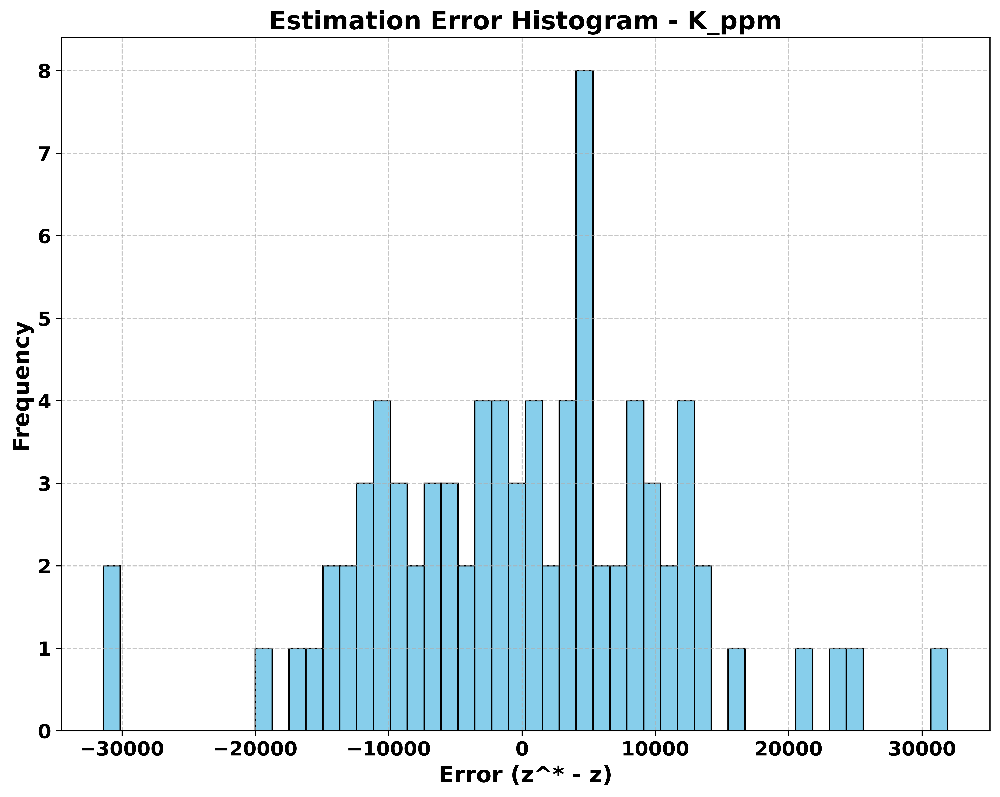

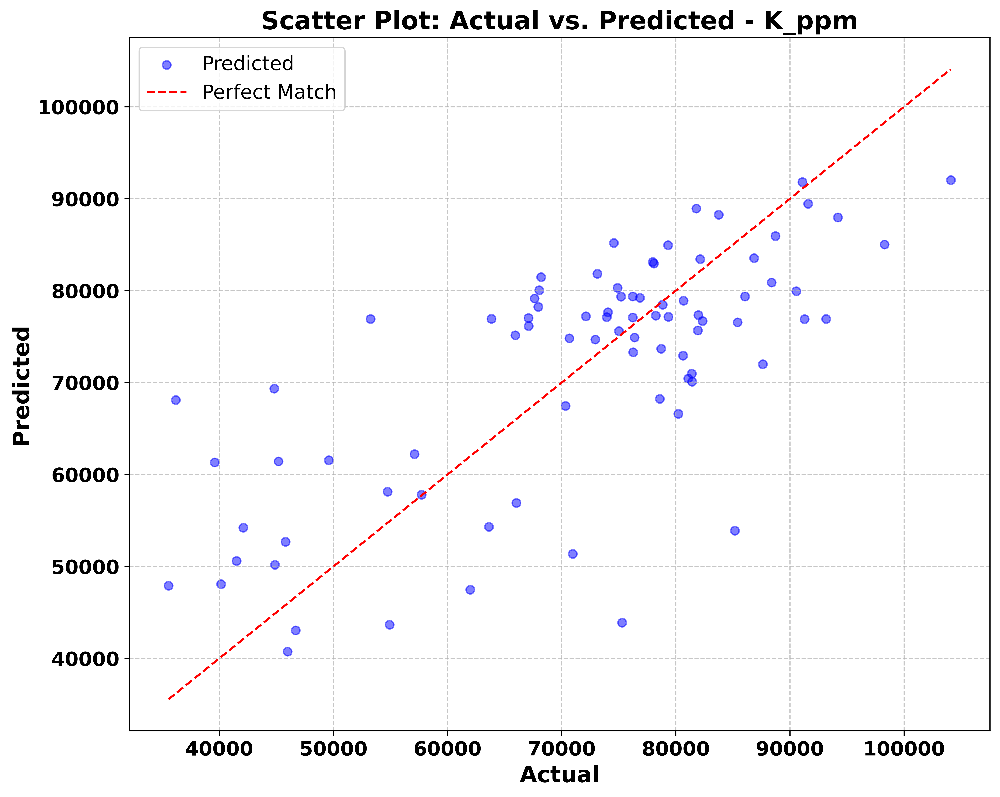

Performing kriging for K_ppm on a 150x150 grid for visualization...


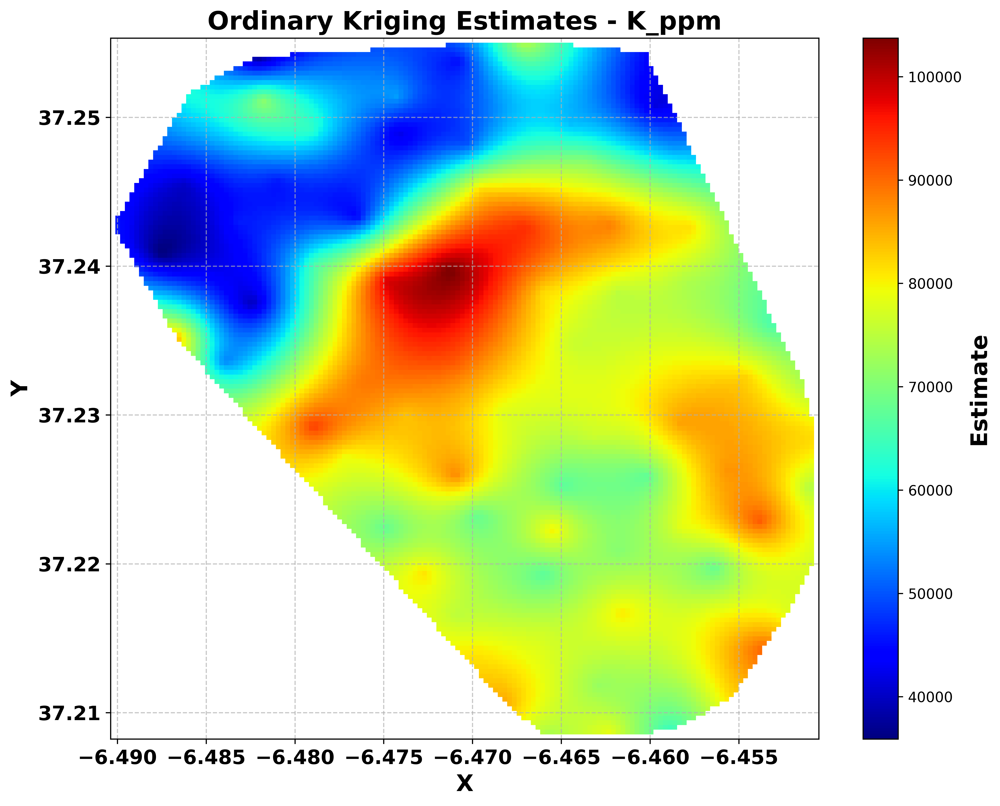

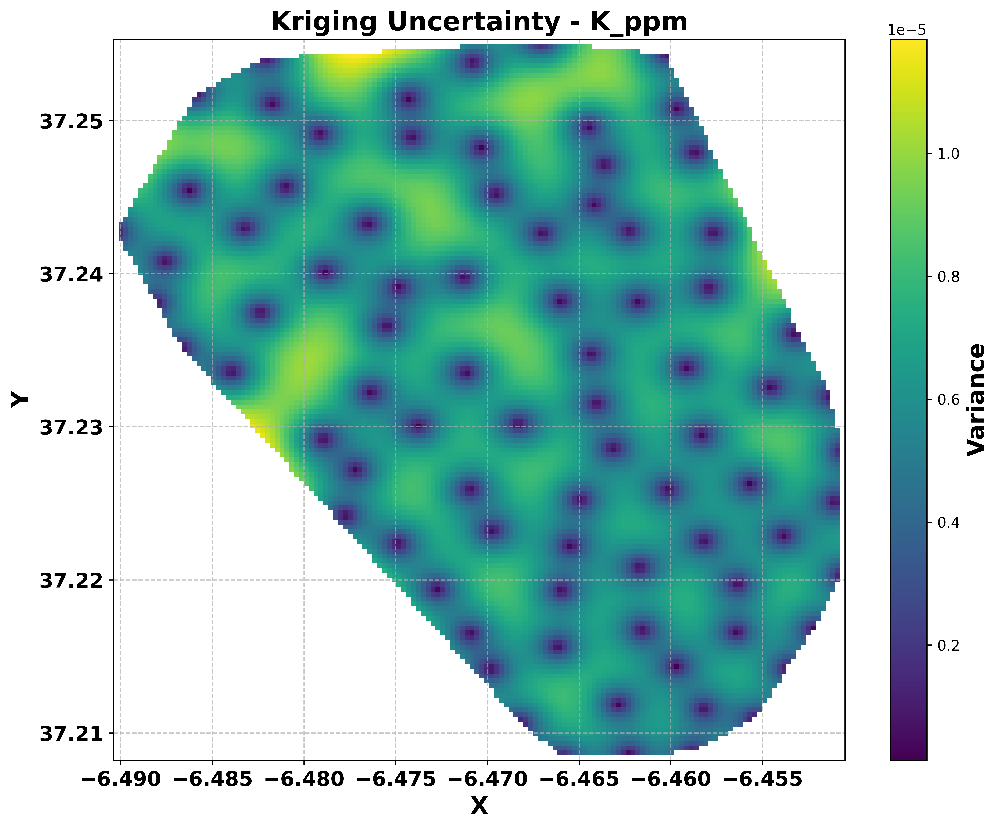

Kriging for K_ppm completed.

Processing S_ppm...
Best variogram parameters for S_ppm: Nugget = 0.4, Sill = 0.5, Range = 50.0


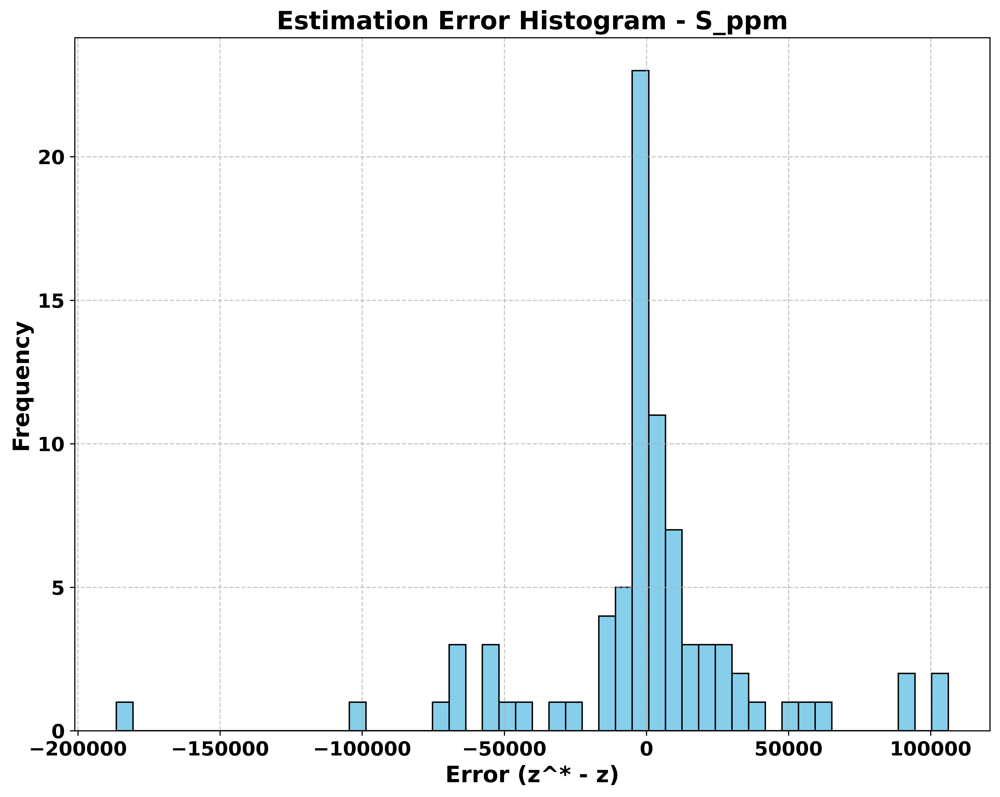

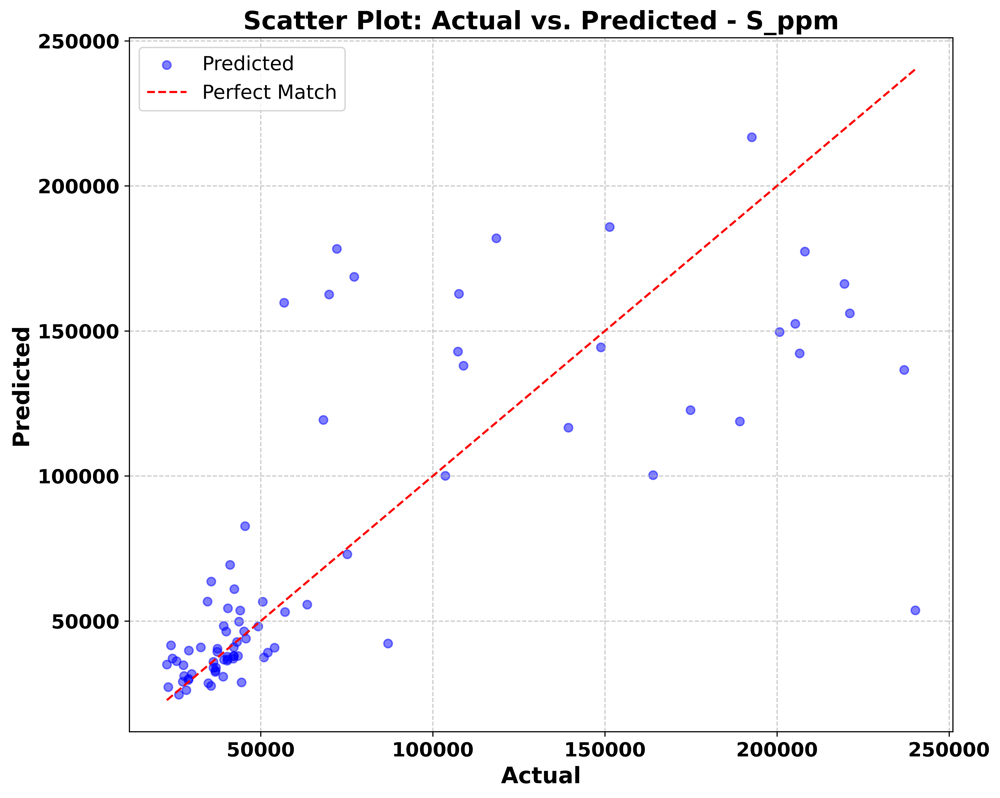

Performing kriging for S_ppm on a 150x150 grid for visualization...


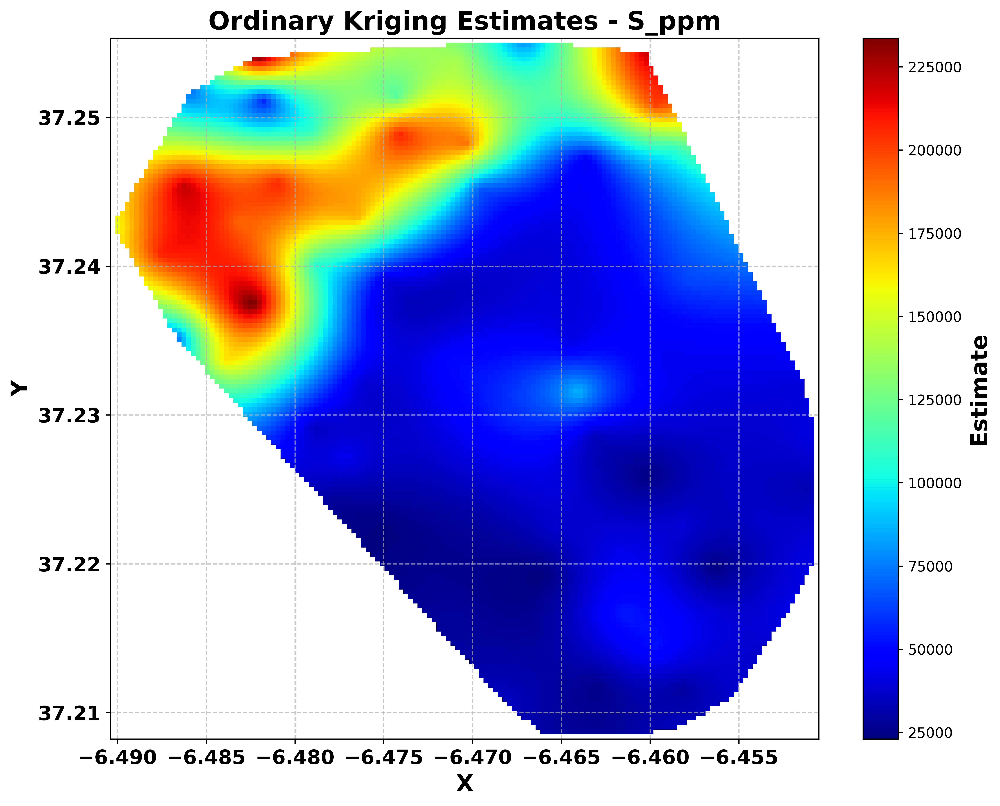

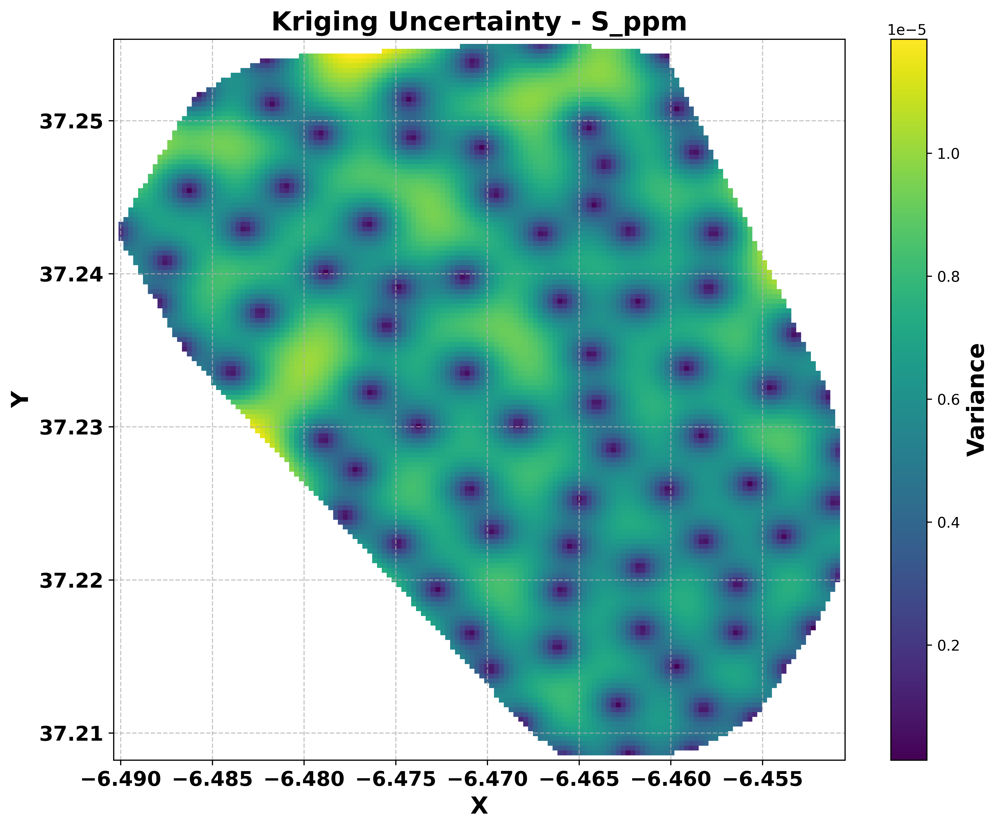

Kriging for S_ppm completed.

Processing Ti_ppm...
Best variogram parameters for Ti_ppm: Nugget = 0.4, Sill = 0.5, Range = 50.0


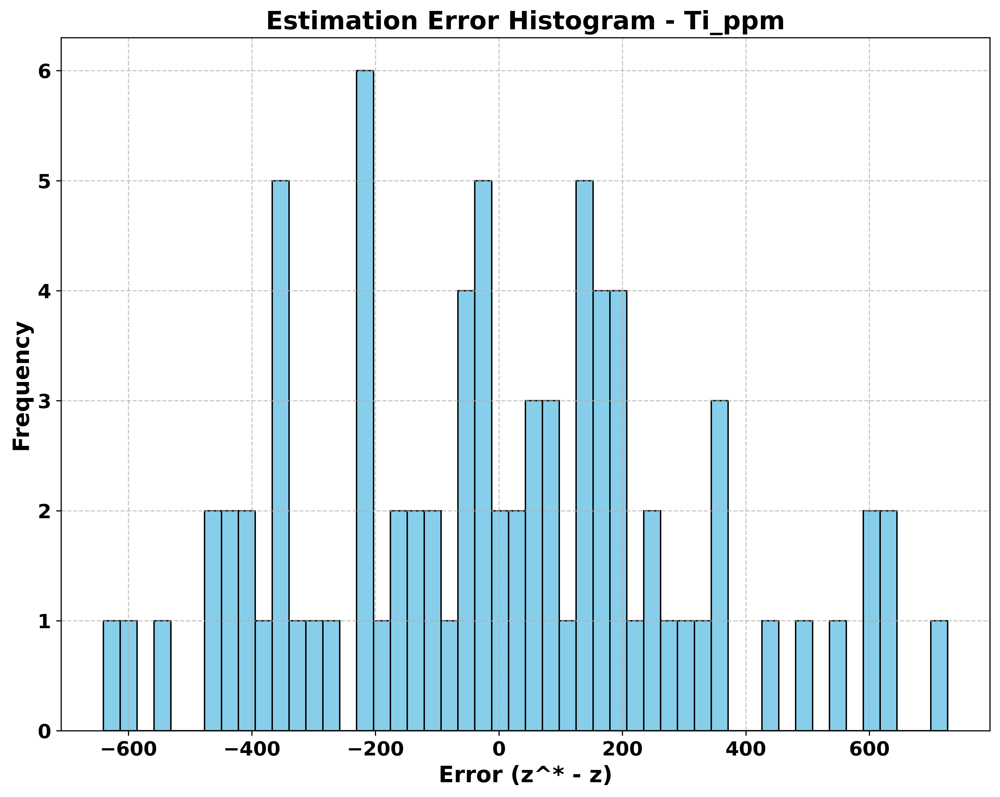

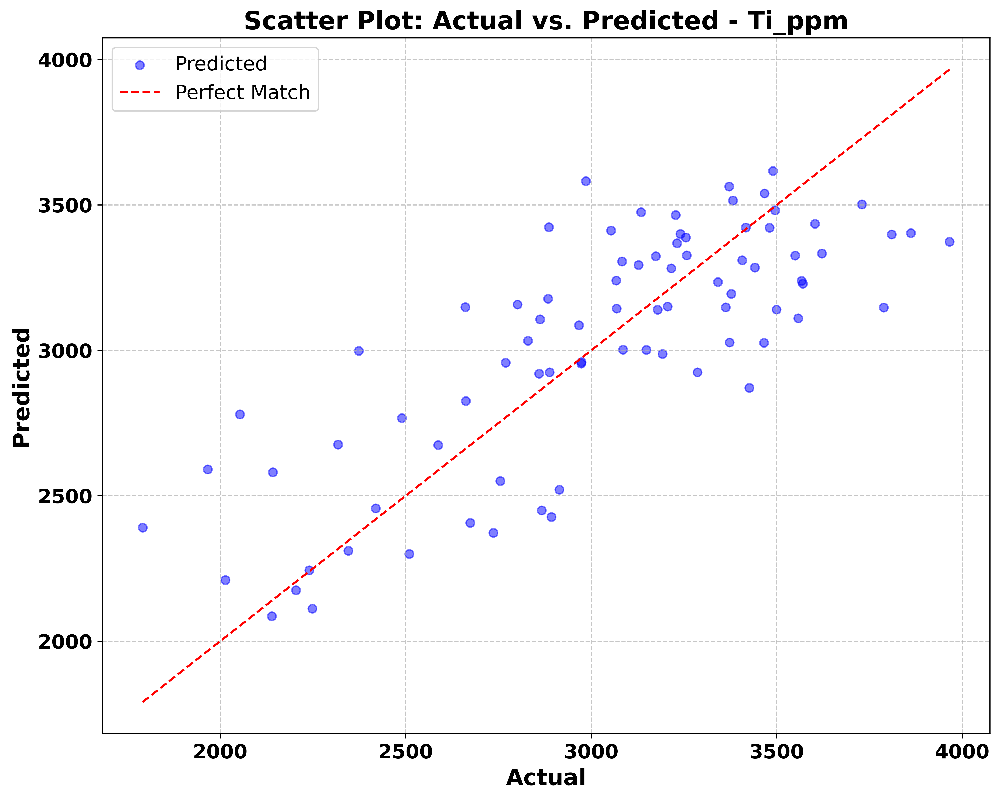

Performing kriging for Ti_ppm on a 150x150 grid for visualization...


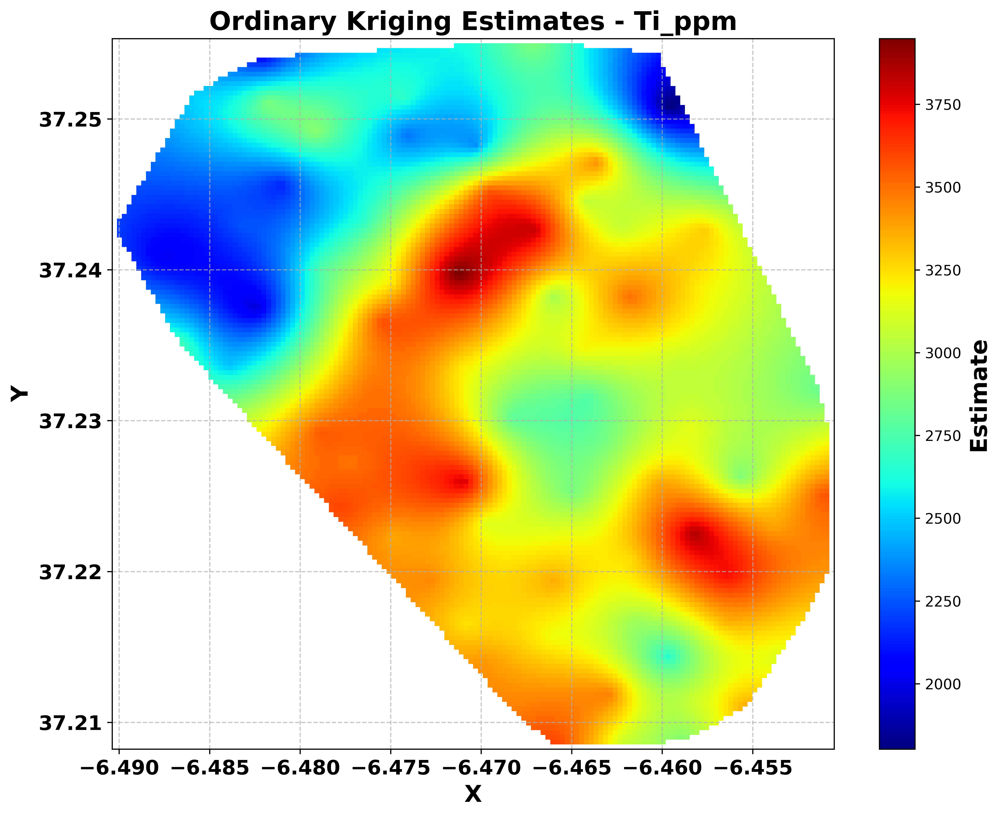

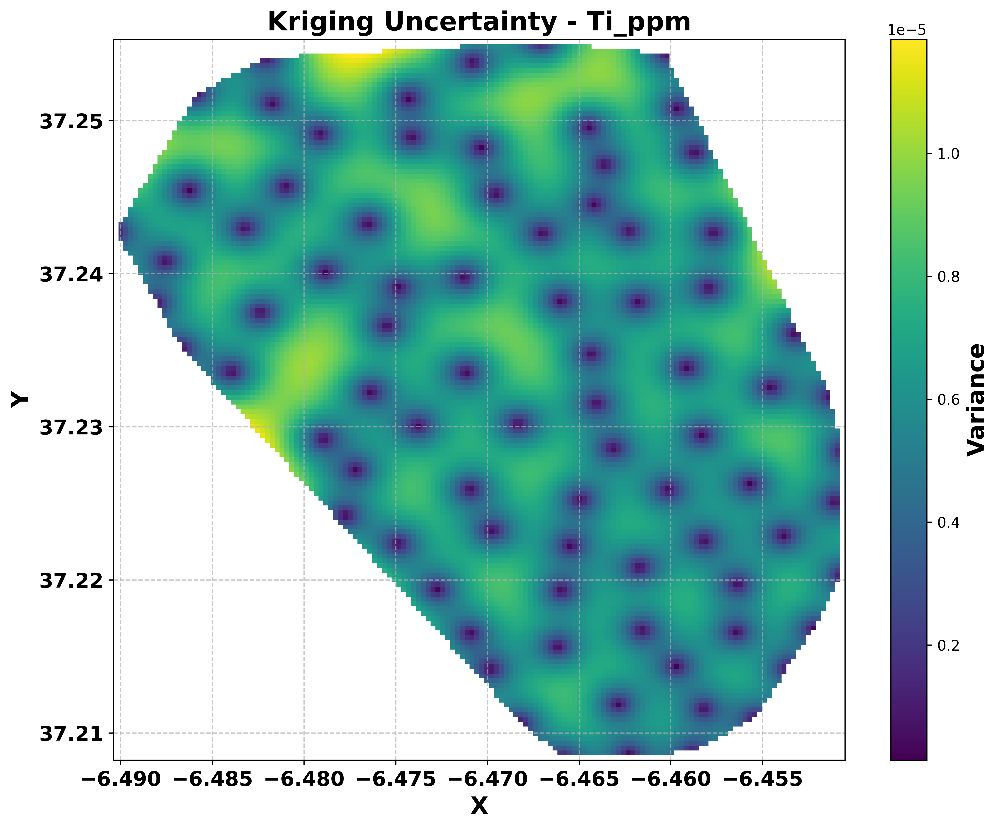

Kriging for Ti_ppm completed.

Processing Mo_ppm...
Best variogram parameters for Mo_ppm: Nugget = 0.5, Sill = 0.6, Range = 50.0


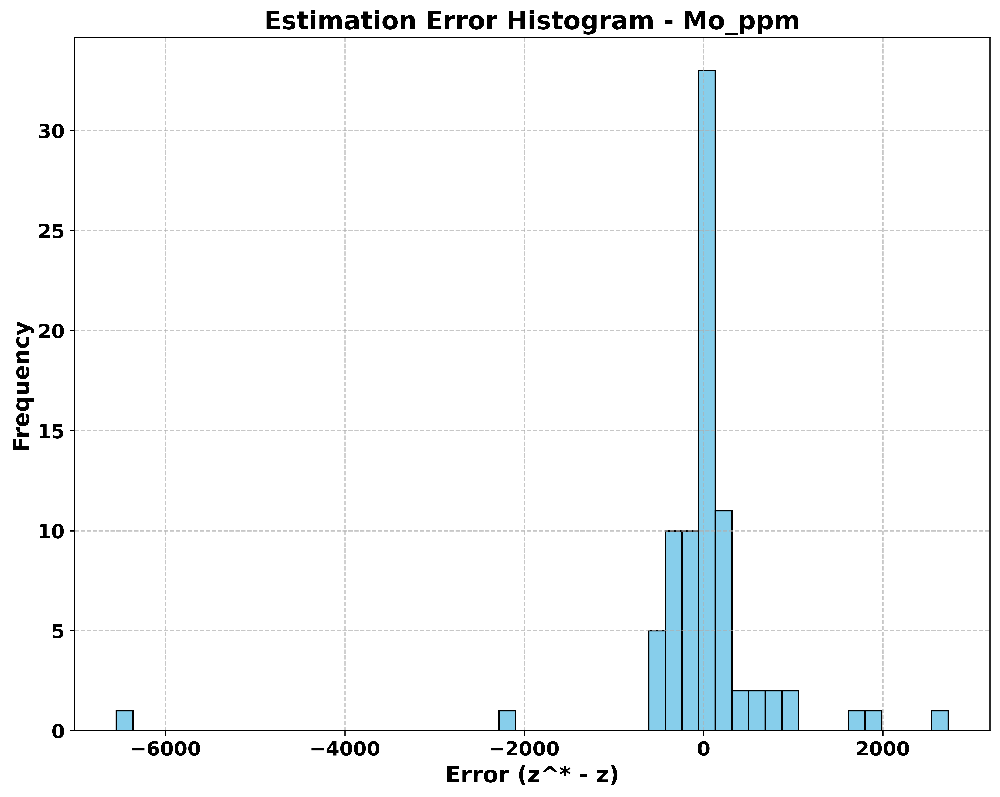

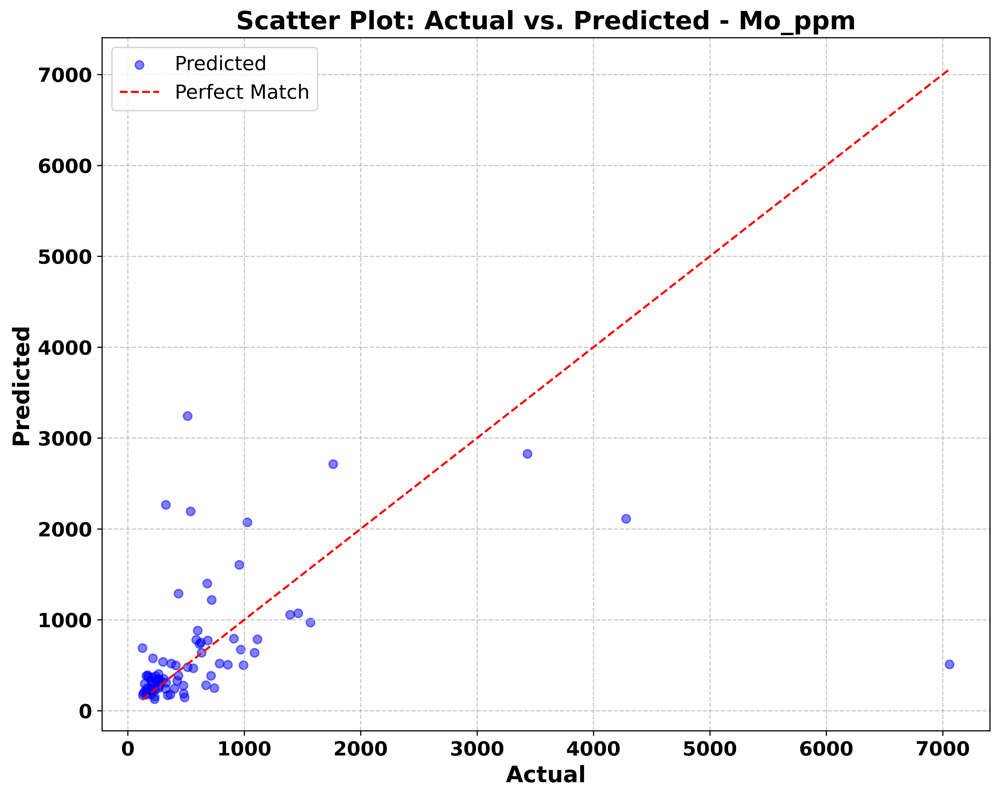

Performing kriging for Mo_ppm on a 150x150 grid for visualization...


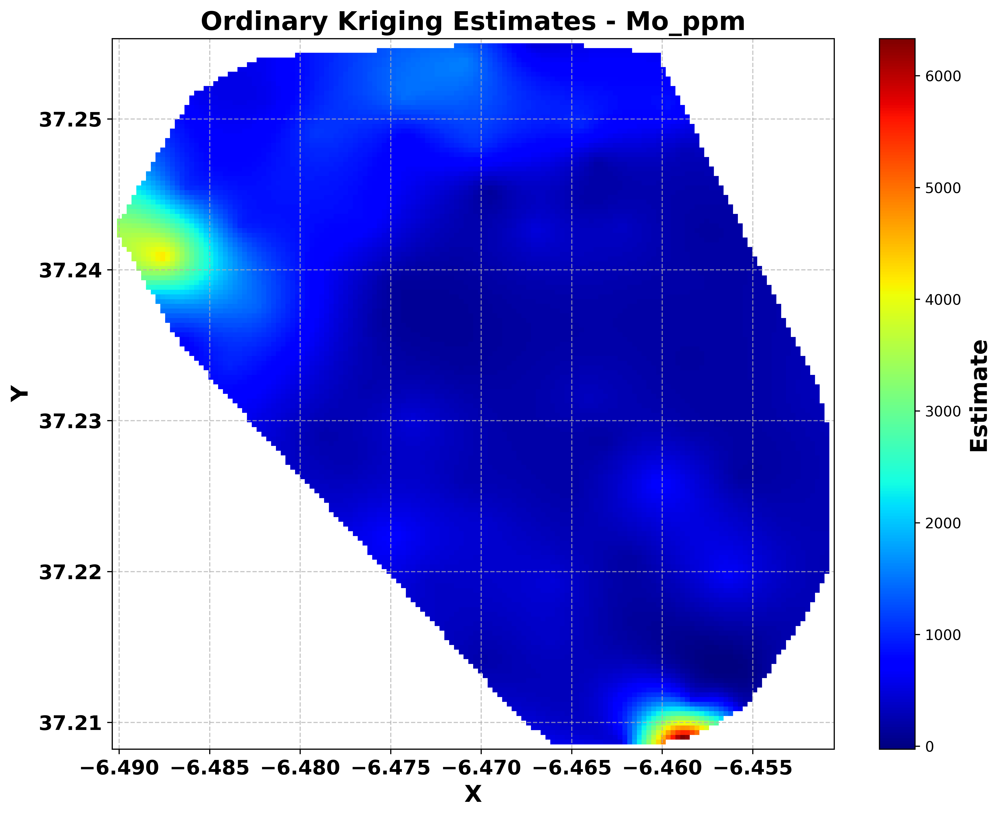

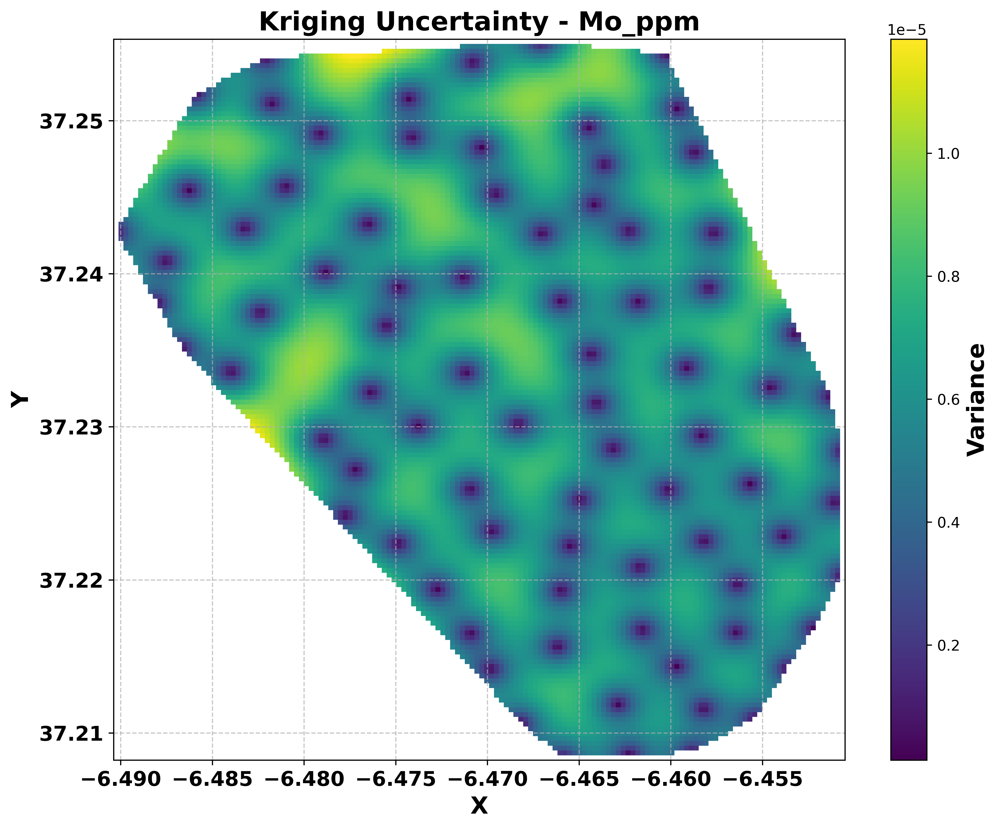

Kriging for Mo_ppm completed.

Processing Mn_ppm...
Best variogram parameters for Mn_ppm: Nugget = 0.2, Sill = 1.0, Range = 100.0


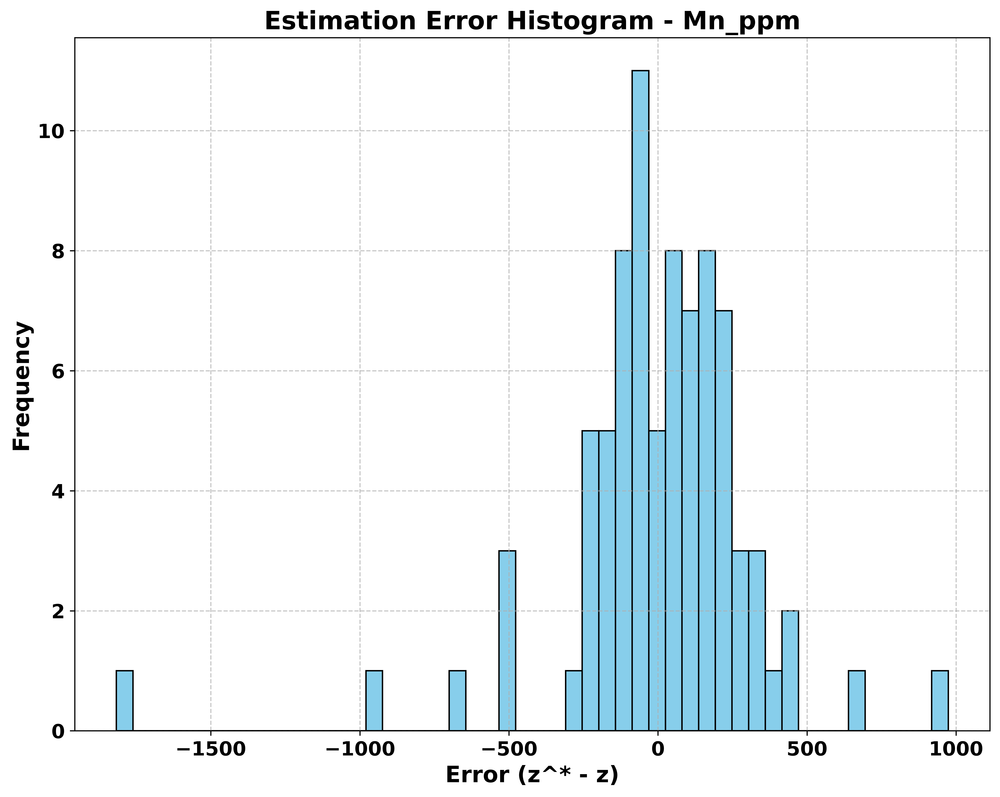

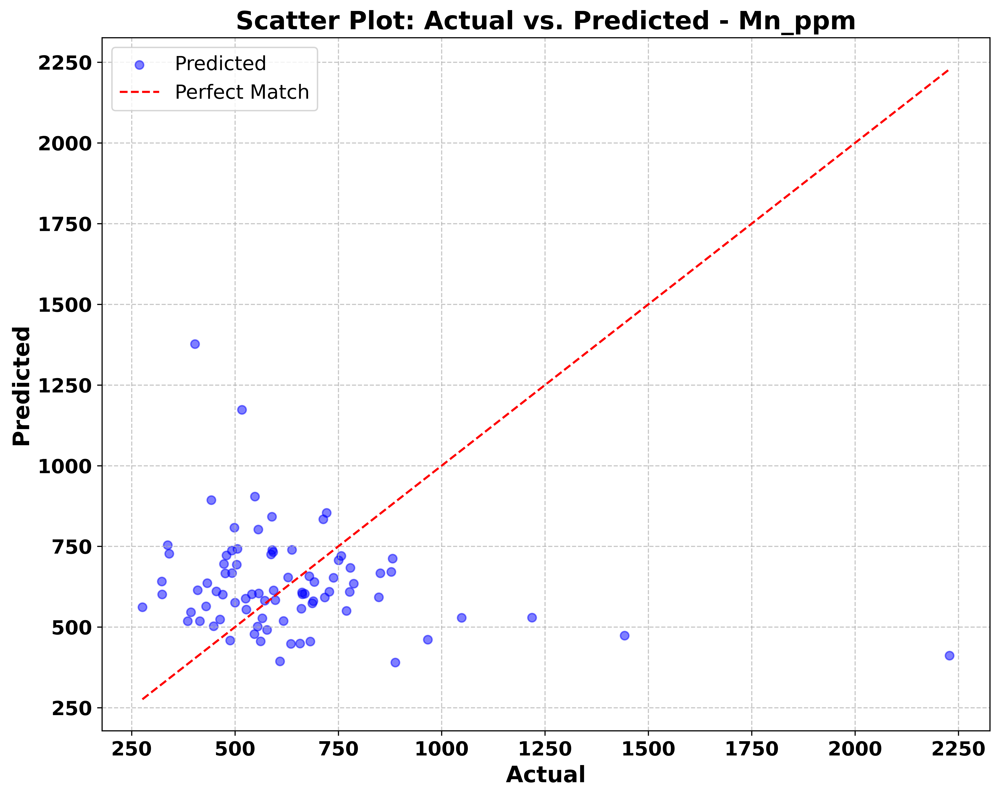

Performing kriging for Mn_ppm on a 150x150 grid for visualization...


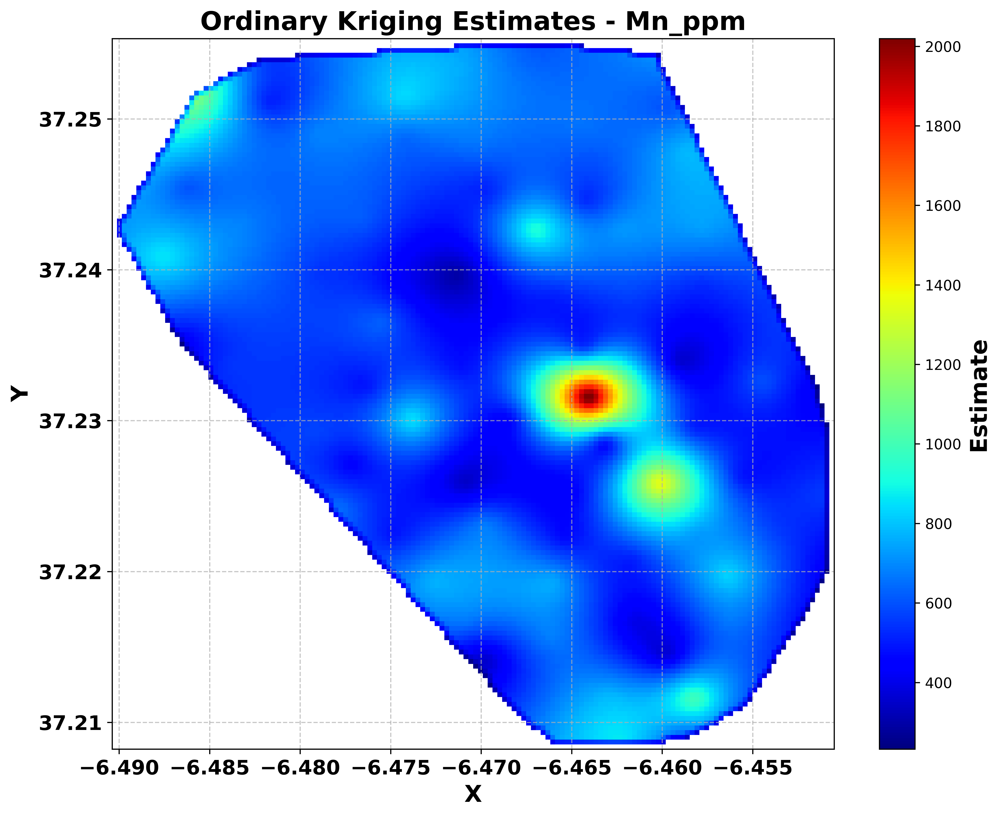

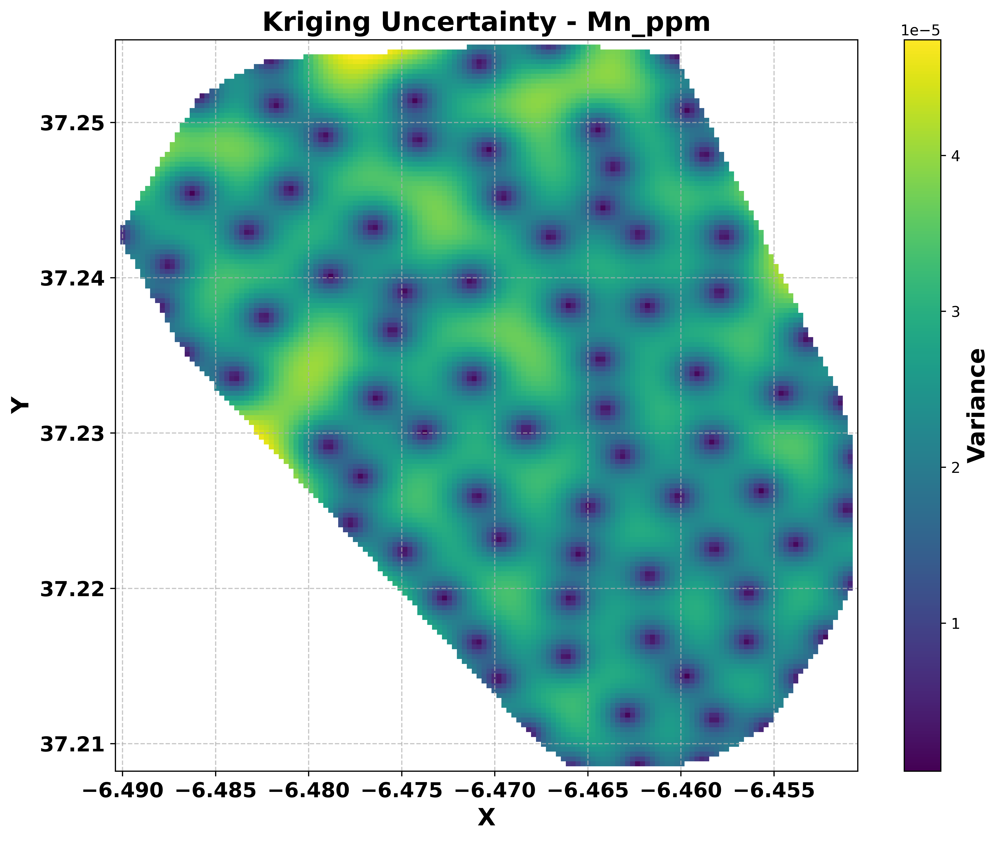

Kriging for Mn_ppm completed.

Processing Sr_ppm...
Best variogram parameters for Sr_ppm: Nugget = 0.0, Sill = 2.0, Range = 10.0


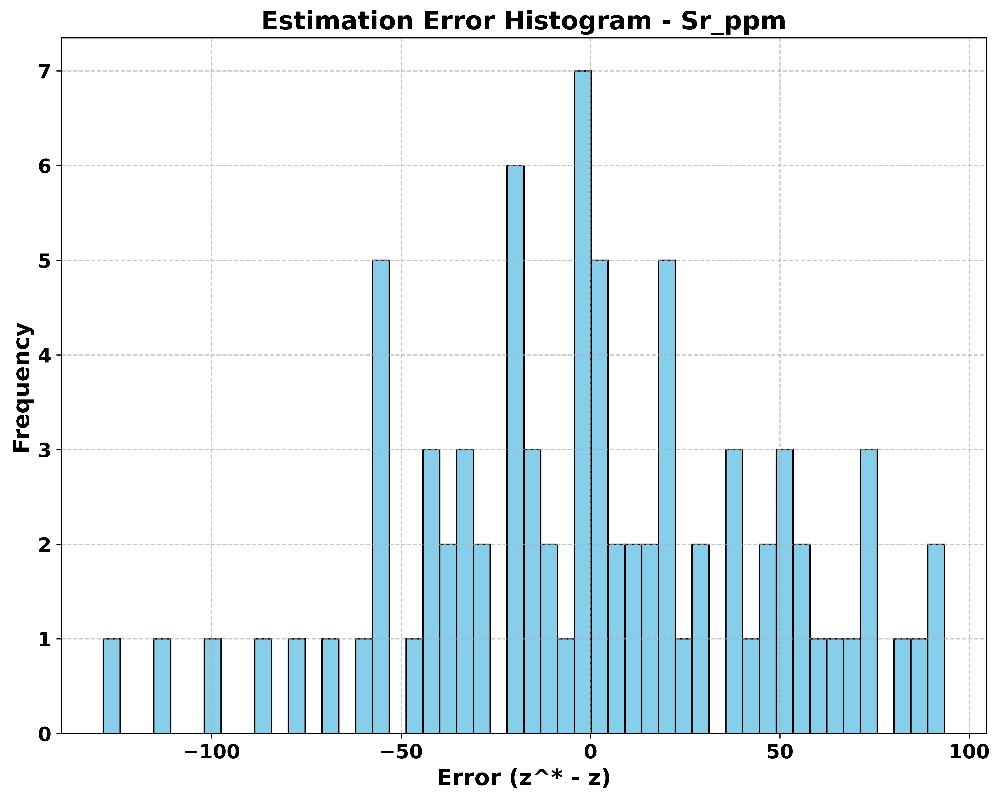

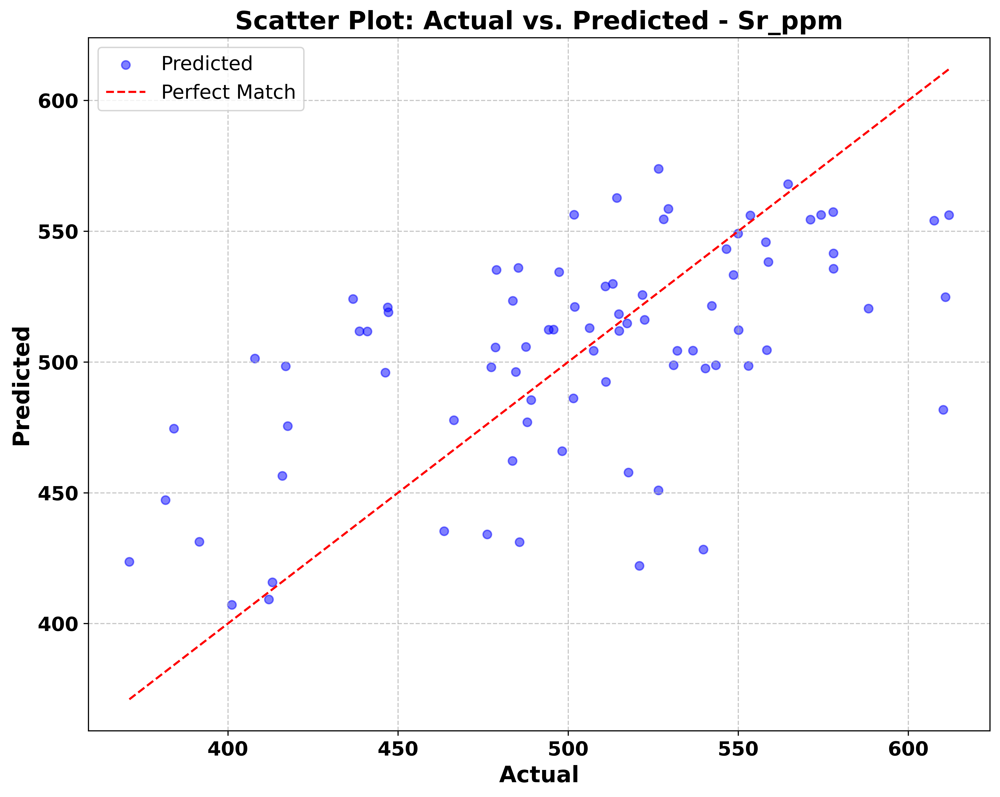

Performing kriging for Sr_ppm on a 150x150 grid for visualization...


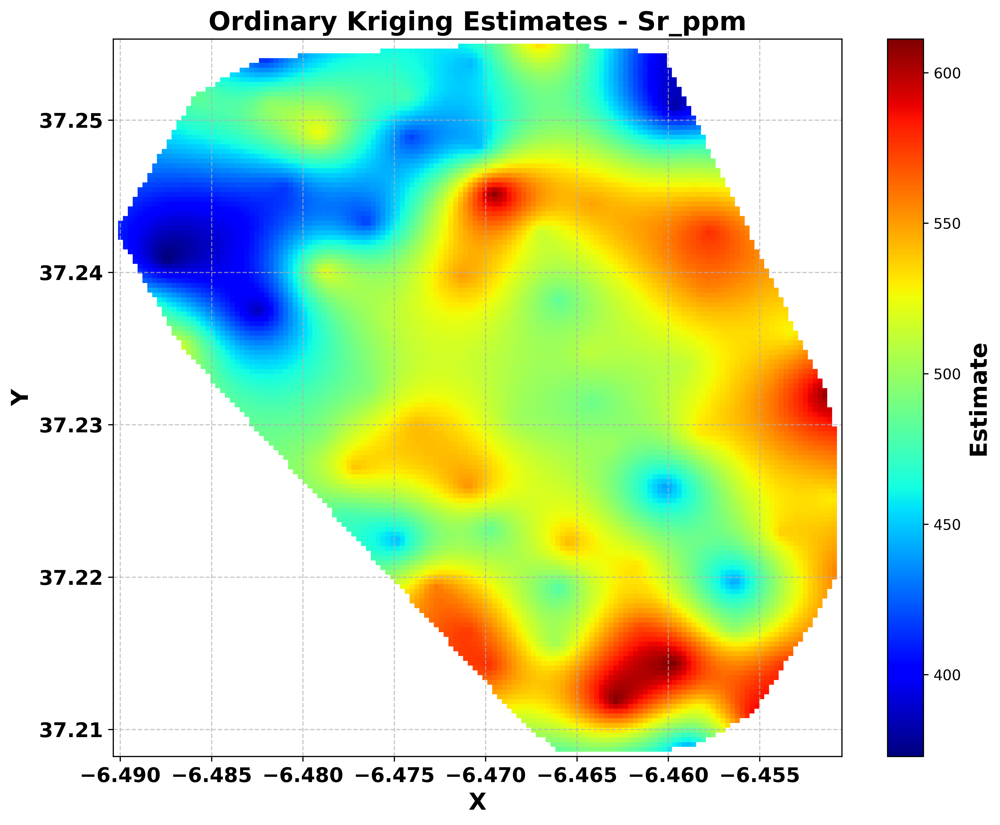

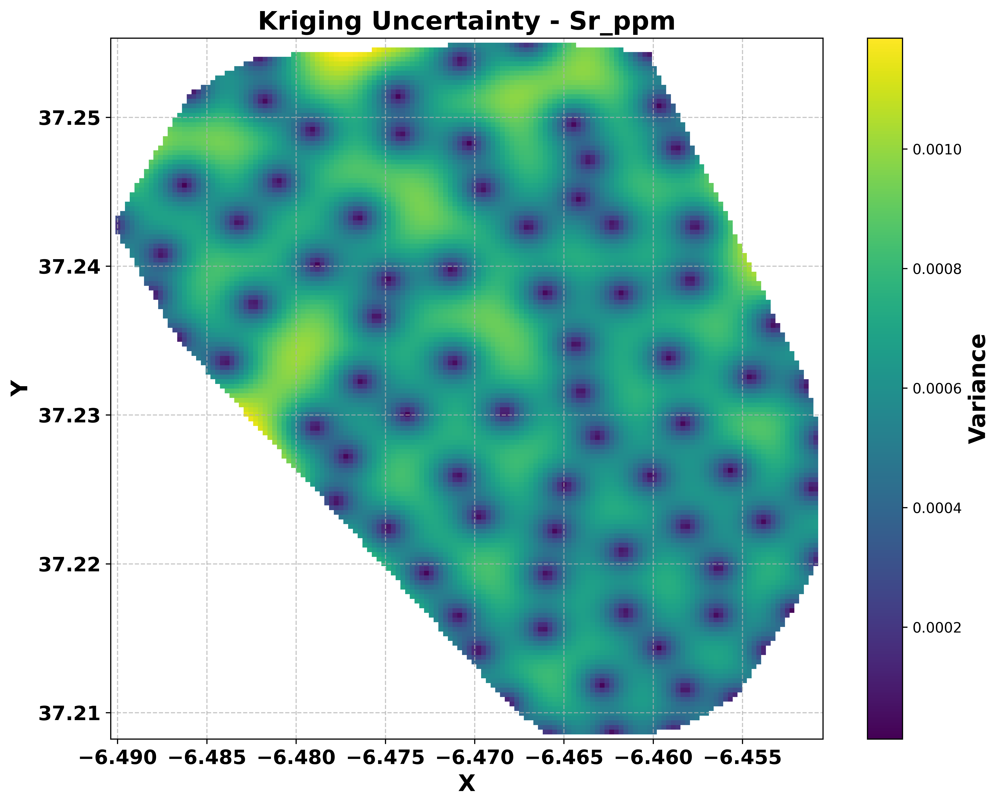

Kriging for Sr_ppm completed.

Processing Zn_ppm...
Best variogram parameters for Zn_ppm: Nugget = 0.5, Sill = 0.6, Range = 50.0


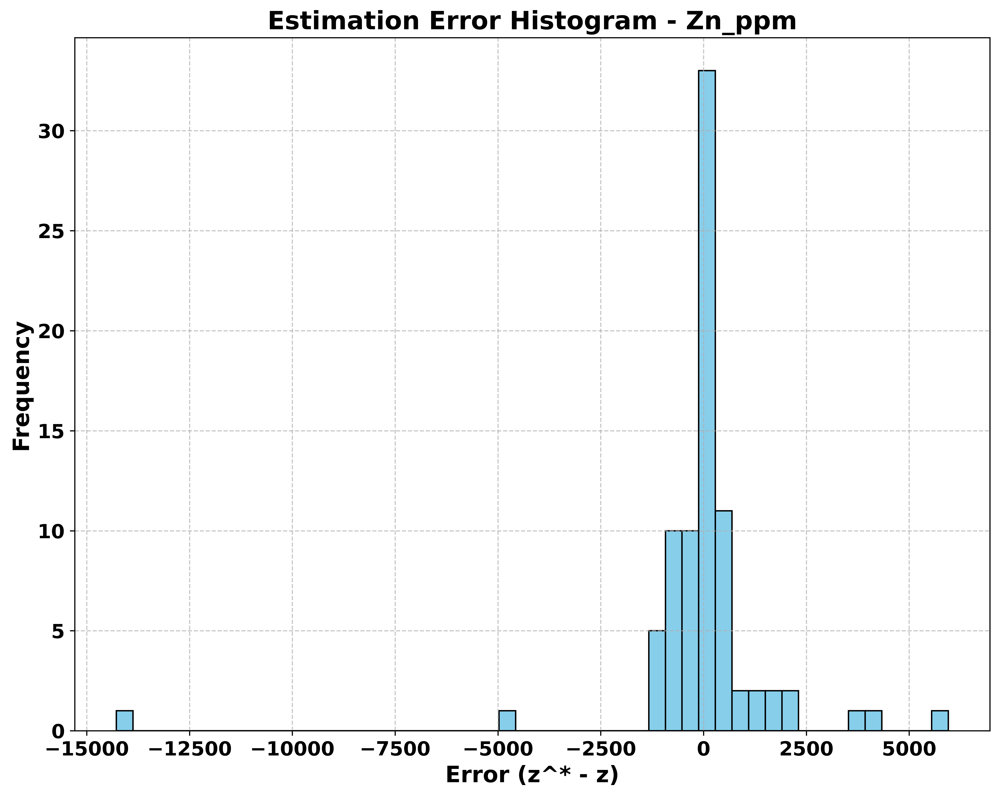

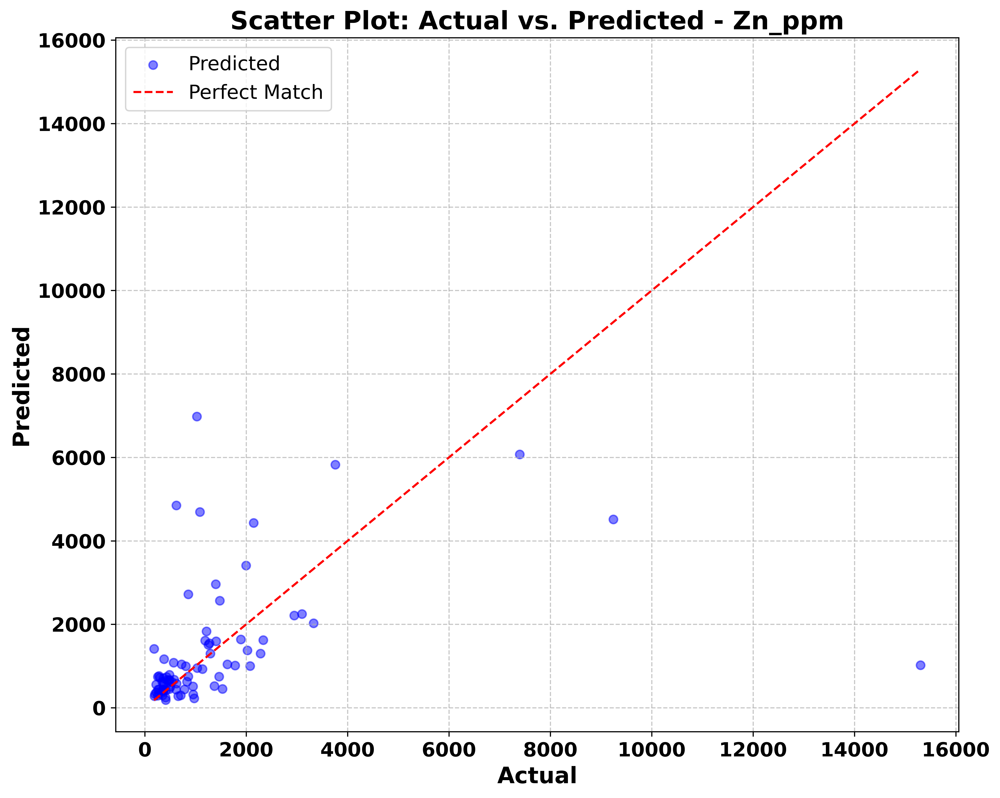

Performing kriging for Zn_ppm on a 150x150 grid for visualization...


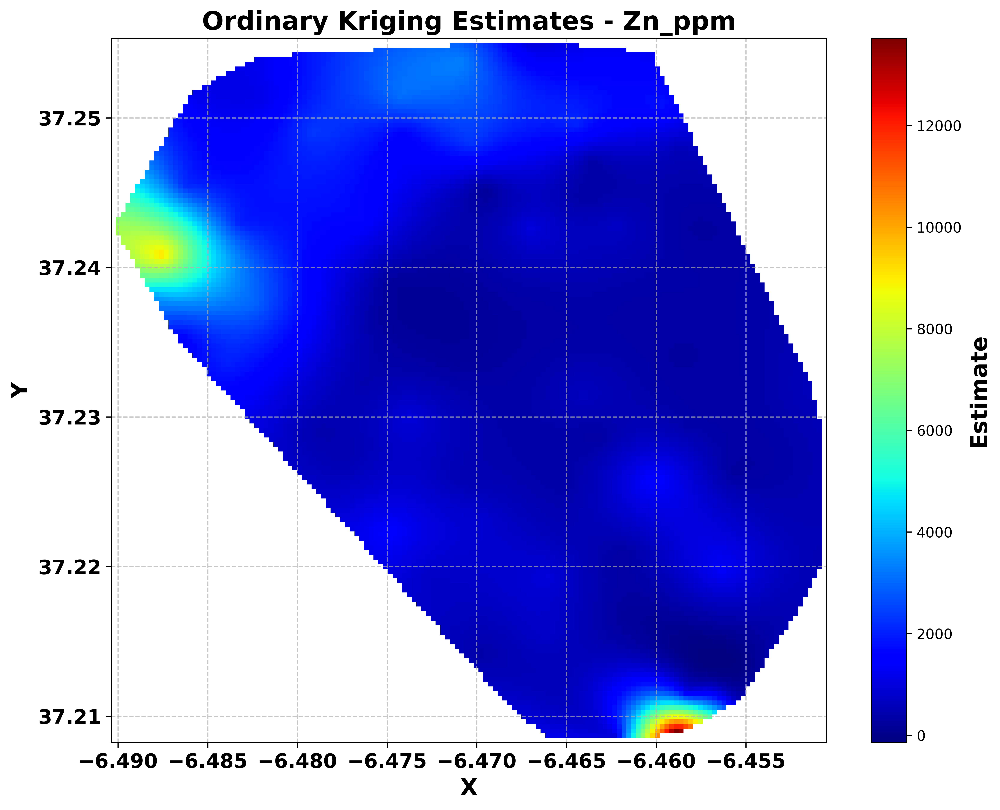

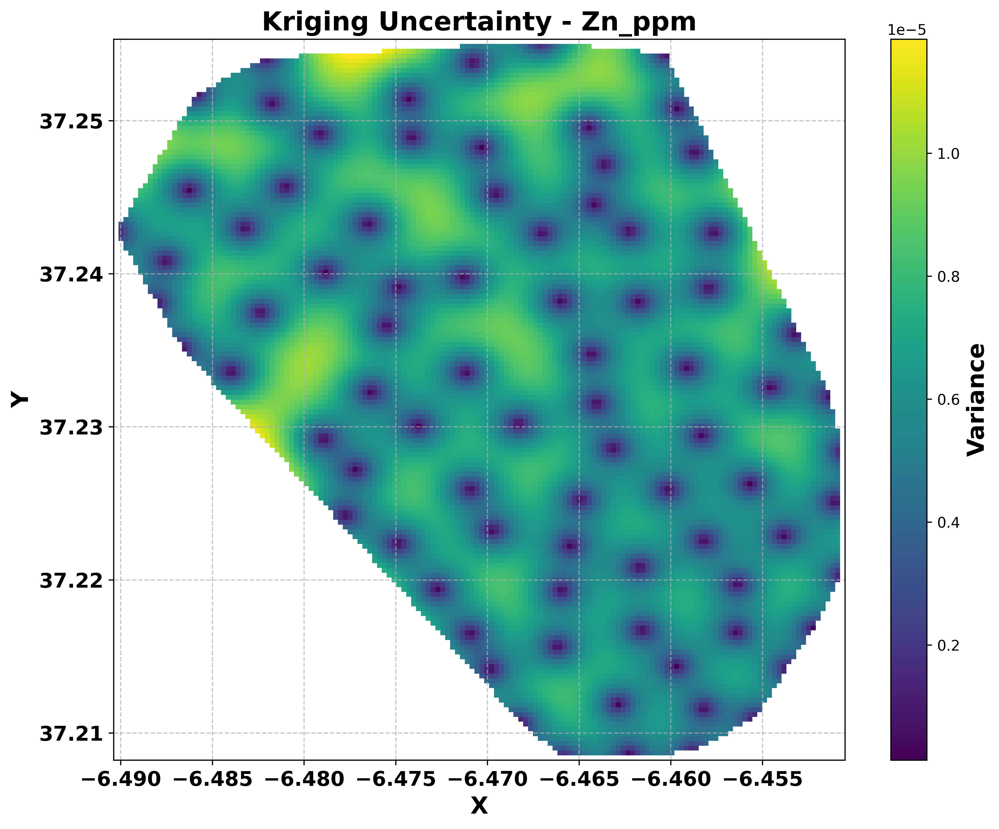

Kriging for Zn_ppm completed.



In [ ]:
"""
Author: Keyumars Anvari
Supervisor: Professor Jörg Benndorf
Affiliation: Department of Mine Surveying and Geodesy, TU Bergakademie Freiberg, 09599 Freiberg, Germany.

Purpose: This script performs variogram modeling, and kriging interpolation.
"""

import geostatspy.geostats as geostats
import numpy as np
import pandas as pd
from scipy.spatial.distance import cdist
from scipy.spatial import ConvexHull, Delaunay
import matplotlib.pyplot as plt
from scipy.ndimage import uniform_filter

# Load your dataset
df = pd.read_excel('1.xlsx')  # Your uploaded geochemical dataset

# Geochemical variables to process
geochemical_vars = ['Ca_ppm', 'Cu_ppm', 'Fe_ppm', 'K_ppm', 'S_ppm',
                   'Ti_ppm', 'Mo_ppm', 'Mn_ppm', 'Sr_ppm', 'Zn_ppm']

# Cross-validation for kriging refinement (for best nugget, sill, and range)
def cross_validation_kriging(df, variable, variogram_model,
                              nugget_range=None, sill_range=None, range_range=None):
    coordinates = df[['X_neu', 'Y_neu']].values
    values = df[variable].values
    n = len(values)

    # Define default ranges if not provided
    if nugget_range is None:
        nugget_range = np.linspace(0.0, 0.5, 6)  # 6 points from 0.0 to 0.5
    if sill_range is None:
        sill_range = np.linspace(0.5, 2.0, 16)   # 16 points from 0.5 to 2.0
    if range_range is None:
        range_range = np.linspace(10.0, 50.0, 9) # 9 points from 10.0 to 50.0

    best_params = None
    best_score = float('inf')

    for nugget in nugget_range:
        for sill in sill_range:
            for range_ in range_range:
                variogram_params = {'nugget': nugget, 'sill': sill, 'range': range_}
                scores = []
                for i in range(n):
                    train_coords = np.delete(coordinates, i, axis=0)
                    train_values = np.delete(values, i)

                    test_point = coordinates[i]
                    true_value = values[i]

                    cov_matrix = compute_cov_matrix(train_coords, variogram_params, variogram_model)
                    distances = compute_distances(train_coords, test_point, variogram_params, variogram_model)
                    kriging_weights, _ = ordinary_kriging(cov_matrix, distances)

                    predicted_value = np.dot(kriging_weights, train_values)
                    score = (predicted_value - true_value) ** 2
                    scores.append(score)

                mean_score = np.mean(scores)
                if mean_score < best_score:
                    best_score = mean_score
                    best_params = variogram_params

    return best_params

# Spherical variogram model
def spherical_variogram(h, nugget, sill, range_):
    return np.where(
        h <= range_,
        nugget + (sill - nugget) * (3 * h / (2 * range_) - (h**3) / (2 * range_**3)),
        sill
    )

# Compute covariance matrix based on variogram model
def compute_cov_matrix(coordinates, variogram_params, variogram_model):
    distances = cdist(coordinates, coordinates)
    return variogram_params['sill'] - variogram_model(distances,
                                                     variogram_params['nugget'],
                                                     variogram_params['sill'],
                                                     variogram_params['range'])

# Compute distances between known points and an unknown point
def compute_distances(known_coords, unknown_point, variogram_params, variogram_model):
    distances = np.linalg.norm(known_coords - unknown_point, axis=1)
    return variogram_params['sill'] - variogram_model(distances,
                                                     variogram_params['nugget'],
                                                     variogram_params['sill'],
                                                     variogram_params['range'])

# Kriging function with uncertainty
def ordinary_kriging(cov_matrix, distances, regularization=1e-10):
    n = cov_matrix.shape[0]
    extended_cov_matrix = np.zeros((n + 1, n + 1))
    extended_cov_matrix[:n, :n] = cov_matrix + np.eye(n) * regularization
    extended_cov_matrix[n, :-1] = 1
    extended_cov_matrix[:-1, n] = 1
    extended_cov_matrix[-1, -1] = 0
    extended_distances = np.append(distances, 1)
    try:
        weights_lagrange = np.linalg.solve(extended_cov_matrix, extended_distances)
    except np.linalg.LinAlgError:
        # Handle singular matrix
        weights_lagrange = np.linalg.lstsq(extended_cov_matrix, extended_distances, rcond=None)[0]
    
    kriging_weights = weights_lagrange[:-1]
    kriging_variance = cov_matrix[0, 0] - np.dot(weights_lagrange[:-1], distances)
    
    return kriging_weights, kriging_variance

# Kriging estimation for a 2D grid, restricted to points inside the convex hull
def kb2d(df, xcol, ycol, vcol, nx, ny, hsiz, variogram_params, variogram_model):
    coordinates = df[[xcol, ycol]].values
    values = df[vcol].values

    # Check for duplicate coordinates and remove them if necessary
    _, unique_indices = np.unique(coordinates, axis=0, return_index=True)
    coordinates = coordinates[unique_indices]
    values = values[unique_indices]

    # Compute convex hull of the borehole locations
    hull = ConvexHull(coordinates)
    hull_path = Delaunay(coordinates[hull.vertices])

    # Create grid for kriging
    x_grid = np.linspace(df[xcol].min(), df[xcol].max(), nx)
    y_grid = np.linspace(df[ycol].min(), df[ycol].max(), ny)
    X_grid, Y_grid = np.meshgrid(x_grid, y_grid)
    est_array = np.full_like(X_grid, np.nan, dtype=np.float64)  # Initialize with NaN (for points outside the hull)
    var_array = np.full_like(X_grid, np.nan, dtype=np.float64)  # For storing kriging variances

    # Precompute the covariance matrix for efficiency
    cov_matrix = compute_cov_matrix(coordinates, variogram_params, variogram_model)

    # Perform ordinary kriging at each grid point only inside the convex hull
    for i in range(nx):
        for j in range(ny):
            unknown_point = np.array([X_grid[i, j], Y_grid[i, j]])
            if hull_path.find_simplex(unknown_point) >= 0:  # Check if the point is inside the convex hull
                distances = compute_distances(coordinates, unknown_point, variogram_params, variogram_model)
                
                # Perform ordinary kriging
                kriging_weights, kriging_variance = ordinary_kriging(cov_matrix, distances)
                
                # Kriging estimate for the grid point
                est_array[i, j] = np.dot(kriging_weights, values)
                var_array[i, j] = kriging_variance  # Store the kriging variance (uncertainty)

    return X_grid, Y_grid, est_array, var_array


# Updated histogram plotting function
def plot_error_histogram(errors, var):
    plt.figure(figsize=(10, 8), dpi=600)
    plt.hist(errors, bins=50, color='skyblue', edgecolor='black')
    plt.title(f'Estimation Error Histogram - {var}', fontsize=18, fontweight='bold')
    plt.xlabel('Error (z^* - z)', fontsize=16, fontweight='bold')
    plt.ylabel('Frequency', fontsize=16, fontweight='bold')
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Updated scatter plot function
def scatter_plot_actual_vs_predicted(actual, predicted, var):
    plt.figure(figsize=(10, 8), dpi=600)
    plt.scatter(actual, predicted, alpha=0.5, color='blue', label='Predicted')
    plt.plot([min(actual), max(actual)], [min(actual), max(actual)], color='red', linestyle='--', label='Perfect Match')
    plt.title(f'Scatter Plot: Actual vs. Predicted - {var}', fontsize=18, fontweight='bold')
    plt.xlabel('Actual', fontsize=16, fontweight='bold')
    plt.ylabel('Predicted', fontsize=16, fontweight='bold')
    plt.legend(fontsize=14)
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Updated kriging result plotting function
def plot_kriging_result(x_grid, y_grid, z_values, title, xlabel, ylabel, color_label, dpi=600):
    plt.figure(figsize=(10, 8), dpi=dpi)
    plt.pcolormesh(x_grid, y_grid, z_values, shading='auto', cmap='jet')
    cbar = plt.colorbar()
    cbar.set_label(color_label, fontsize=16, fontweight='bold')
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Updated kriging uncertainty plotting function
def plot_kriging_uncertainty(x_grid, y_grid, uncertainty_values, title, xlabel, ylabel, color_label, dpi=600):
    plt.figure(figsize=(10, 8), dpi=dpi)
    plt.pcolormesh(x_grid, y_grid, uncertainty_values, shading='auto', cmap='viridis')
    cbar = plt.colorbar()
    cbar.set_label(color_label, fontsize=16, fontweight='bold')
    plt.title(title, fontsize=18, fontweight='bold')
    plt.xlabel(xlabel, fontsize=16, fontweight='bold')
    plt.ylabel(ylabel, fontsize=16, fontweight='bold')
    plt.xticks(fontsize=14, fontweight='bold')
    plt.yticks(fontsize=14, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.7)
    plt.tight_layout()
    plt.show()

# Surface kriging (first sample per borehole)
df_surface_kriging = df.groupby('Push_Name').first().reset_index()

# Perform kriging for borehole points to compute estimation error
def kriging_for_boreholes(df, xcol, ycol, vcol, variogram_params, variogram_model):
    coordinates = df[[xcol, ycol]].values
    values = df[vcol].values

    predicted_values = []
    errors = []

    for i in range(len(values)):
        # Leave-one-out: exclude the current point from the neighbors
        known_coords = np.delete(coordinates, i, axis=0)
        known_values = np.delete(values, i)

        test_point = coordinates[i]
        true_value = values[i]

        # Compute covariance matrix and distances
        cov_matrix = compute_cov_matrix(known_coords, variogram_params, variogram_model)
        distances = compute_distances(known_coords, test_point, variogram_params, variogram_model)

        # Perform ordinary kriging
        kriging_weights, _ = ordinary_kriging(cov_matrix, distances)
        predicted_value = np.dot(kriging_weights, known_values)

        predicted_values.append(predicted_value)
        errors.append(predicted_value - true_value)  # z^* - z

    return np.array(predicted_values), np.array(errors)

# Initialize an empty list to store results for each variable
kriging_results = []

# Initialize a list to store cross-validation results
cross_validation_results = []

# Loop through each geochemical variable for variogram modeling and kriging
for var in geochemical_vars:
    print(f"Processing {var}...")

    # Define custom variogram parameter ranges for Mn_ppm to ensure smoothness
    if var == 'Mn_ppm':
        # Example: Lower nugget, higher sill, larger range for smoother results
        custom_nugget_range = np.linspace(0.0, 0.2, 5)       # 0.0 to 0.2
        custom_sill_range = np.linspace(1.0, 3.0, 21)        # 1.0 to 3.0
        custom_range_range = np.linspace(20.0, 100.0, 9)     # 20 to 100
        best_params = cross_validation_kriging(
            df_surface_kriging, var, spherical_variogram,
            nugget_range=custom_nugget_range,
            sill_range=custom_sill_range,
            range_range=custom_range_range
        )
    else:
        # Use default variogram parameter ranges
        best_params = cross_validation_kriging(df_surface_kriging, var, spherical_variogram)
    
    print(f"Best variogram parameters for {var}: Nugget = {best_params['nugget']}, "
          f"Sill = {best_params['sill']}, Range = {best_params['range']}")

    # Perform kriging at borehole points to calculate estimation errors
    predicted_borehole_values, borehole_errors = kriging_for_boreholes(
        df_surface_kriging, 'X_neu', 'Y_neu', var, best_params, spherical_variogram
    )

    # Plot histogram of estimation errors (E[z^*-z])
    plot_error_histogram(borehole_errors, var)

    # Plot scatter of actual vs predicted for borehole points
    scatter_plot_actual_vs_predicted(df_surface_kriging[var].values, predicted_borehole_values, var)

    # Perform grid-based kriging for visualization purposes
    print(f"Performing kriging for {var} on a 150x150 grid for visualization...")

    # Perform kriging on a finer grid (150x150) for visualization
    X_grid, Y_grid, est_array, var_array = kb2d(
        df_surface_kriging, 'X_neu', 'Y_neu', var,
        nx=150, ny=150, hsiz=10,
        variogram_params=best_params,
        variogram_model=spherical_variogram
    )

    # Apply smoothing specifically to Mn_ppm kriging estimates
    if var == 'Mn_ppm':
        # Create a mask of non-NaN values to prevent smoothing over NaNs
        valid_mask = ~np.isnan(est_array)
        
        # Temporarily fill NaNs for smoothing, then revert them back
        est_array_filled = np.where(valid_mask, est_array, 0.0)
        est_array_smoothed = uniform_filter(est_array_filled, size=3)
        
        # Apply smoothing only where original values were valid
        est_array = np.where(valid_mask, est_array_smoothed, np.nan)

    # Plot the kriging estimates with higher resolution
    plot_kriging_result(
        X_grid, Y_grid, est_array,
        f'Ordinary Kriging Estimates - {var}',
        'X', 'Y', 'Estimate', dpi=600
    )

    # Plot the kriging uncertainty (variance) with higher resolution
    plot_kriging_uncertainty(
        X_grid, Y_grid, var_array,
        f'Kriging Uncertainty - {var}',
        'X', 'Y', 'Variance', dpi=600
    )

    print(f"Kriging for {var} completed.\n")

    # Create a DataFrame for known values (borehole points)
    known_df = pd.DataFrame({
        'X': df_surface_kriging['X_neu'],
        'Y': df_surface_kriging['Y_neu'],
        'Type': 'Known',
        f'{var}_Actual': df_surface_kriging[var],
        f'{var}_Predicted': predicted_borehole_values
    })

    # Perform kriging on a finer grid (150x150) for unknown points
    # (Recompute est_array and var_array if needed, or reuse from above)
    # Here, we reuse the est_array obtained earlier
    unknown_df = pd.DataFrame({
        'X': X_grid.flatten(),
        'Y': Y_grid.flatten(),
        'Type': 'Unknown',
        f'{var}_Predicted': est_array.flatten()
    })

    # Combine known and unknown data for this variable
    combined_df = pd.concat([known_df, unknown_df], ignore_index=True)

    # Add the combined results for this variable to the kriging_results list
    kriging_results.append(combined_df)

    # Store the cross-validation results
    cross_validation_results.append({
        'Variable': var,
        'Nugget': best_params['nugget'],
        'Sill': best_params['sill'],
        'Range': best_params['range']
    })

# Combine the results for all variables into a single DataFrame
# To prevent column name overlaps, add variable names as prefixes
combined_kriging_dfs = []
for df_var in kriging_results:
    # Assuming each df_var has columns: X, Y, Type, <var>_Actual, <var>_Predicted
    combined_kriging_dfs.append(df_var)

# Save each variable's results to separate sheets in the Excel file
with pd.ExcelWriter('kriging_results_all_variables.xlsx') as writer:
    for idx, var in enumerate(geochemical_vars):
        combined_kriging_dfs[idx].to_excel(writer, sheet_name=var, index=False)
    # Optionally, add a summary sheet for cross-validation results
    df_cross_validation = pd.DataFrame(cross_validation_results)
    df_cross_validation.to_excel(writer, sheet_name='Cross_Validation', index=False)

print("Saved kriging results for all variables to 'kriging_results_all_variables.xlsx'.")

# Additionally, save cross-validation results to a separate Excel file if needed
df_cross_validation.to_excel('cross_validation_results.xlsx', index=False)
print("Saved cross-validation results to 'cross_validation_results.xlsx'.")
